In [4]:
import pandas as pd
import numpy as np
import base64
import io
from matplotlib import pyplot as plt
import matplotlib.image as mpimg

import Network_Plots as NPlots
import Driver_Plots as DPlots
import DistMatrix_Plots as DMPlots
import Silhouette_Plots as SPlots
import RadarMeter_Plots as RPlots
import Geographical_Plots as GPlots
# from Geographical_Plots import 
import Setup

import pycountry
import us
import pycountry
import plotly.express as px
import plotly.graph_objects as go

from Setup import glb_rates_metadata, state_rates_metadata

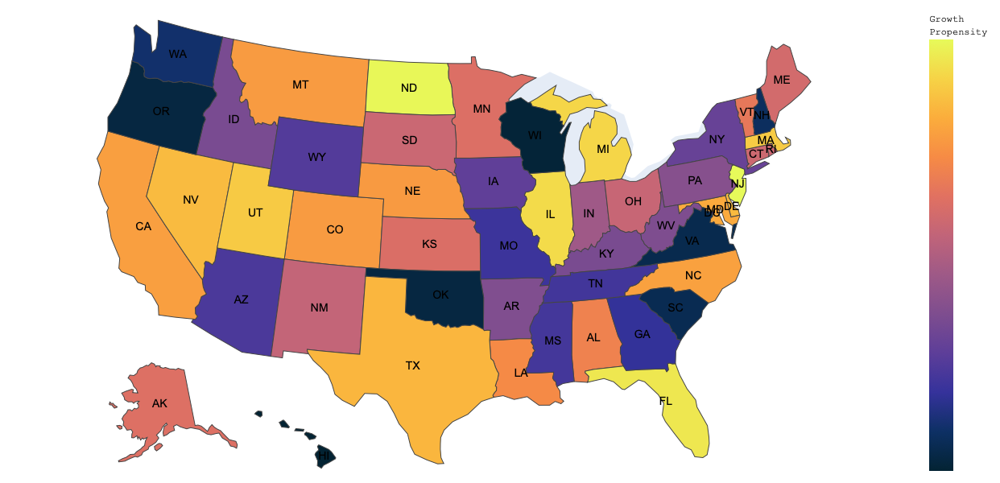

In [5]:
GPlots.plot_usa_states_hotzones(state_rates_metadata)

In [2]:
Setup.nuts1_rates_metadata

,Country,NUTS1,Growth
0,AL,Shqipëria,0.350268
1,AT,Ostösterreich,0.350008
2,AT,Südösterreich,0.216843
3,AT,Westösterreich,0.755311
4,BE,Région wallonne,0.746687
...,...,...,...
102,TR,Doğu Marmara,0.728973
103,TR,Ortadoğu Anadolu,0.805730
104,TR,İstanbul,0.484291
105,TR,Kuzeydoğu Anadolu,0.253795


In [33]:
GPlots.nuts_name_map["2"]

{'Veri': 'AL01',
 'Qender': 'AL02',
 'Jug': 'AL03',
 'Burgenland': 'AT11',
 'Steiermark': 'AT22',
 'Tirol': 'AT33',
 'Niederösterreich': 'AT12',
 'Vorarlberg': 'AT34',
 'Oberösterreich': 'AT31',
 'Salzburg': 'AT32',
 'Kärnten': 'AT21',
 'Wien': 'AT13',
 'Prov. Vlaams-Brabant': 'BE24',
 'Prov. West-Vlaanderen': 'BE25',
 'Prov. Limburg (BE)': 'BE22',
 'Prov. Oost-Vlaanderen': 'BE23',
 'Région de Bruxelles-Capitale/ Brussels Hoofdstedelijk Gewest': 'BE10',
 'Prov. Antwerpen': 'BE21',
 'Prov. Liège': 'BE33',
 'Prov. Brabant Wallon': 'BE31',
 'Prov. Hainaut': 'BE32',
 'Prov. Luxembourg (BE)': 'BE34',
 'Prov. Namur': 'BE35',
 'Severoiztochen': 'BG33',
 'Yugoiztochen': 'BG34',
 'Yugozapaden': 'BG41',
 'Severen tsentralen': 'BG32',
 'Yuzhen tsentralen': 'BG42',
 'Severozapaden': 'BG31',
 'Ostschweiz': 'CH05',
 'Région lémanique': 'CH01',
 'Ticino': 'CH07',
 'Zentralschweiz': 'CH06',
 'Espace Mittelland': 'CH02',
 'Nordwestschweiz': 'CH03',
 'Zürich': 'CH04',
 'Kýpros': 'CY00',
 'Střední Čechy'

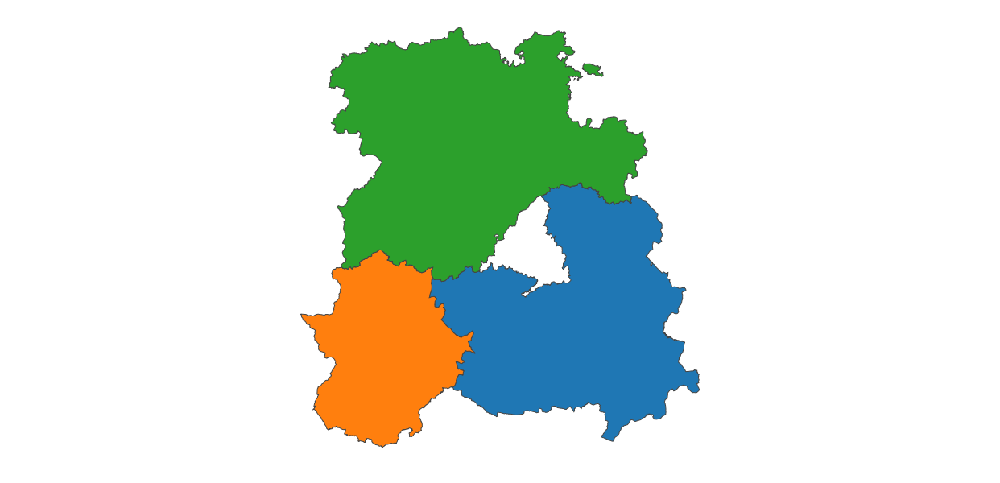

In [34]:
GPlots.plot_nuts_country("ESP", 2, "Centro (ES)")

In [42]:
lmm = ['Castilla-La Mancha', 'Extremadura', 'Castilla y León']
outp = Setup.nuts2_rates_metadata

In [46]:
sub = outp[(outp["Country"] == "ES") & (outp["NUTS1"] == "ES4")]
sub

,Country,NUTS1,NUTS2,Growth
88,ES,ES4,Castilla-La Mancha,0.836800
89,ES,ES4,Extremadura,0.487967
90,ES,ES4,Castilla y León,0.758348


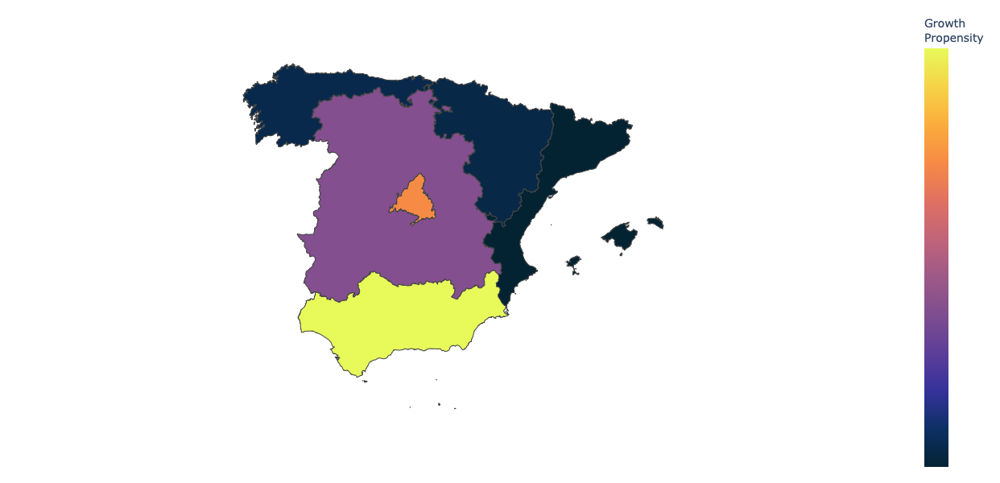

In [27]:
plot_nuts_country_hotzones("ESP", Setup.nuts1_rates_metadata, 1)

ES4


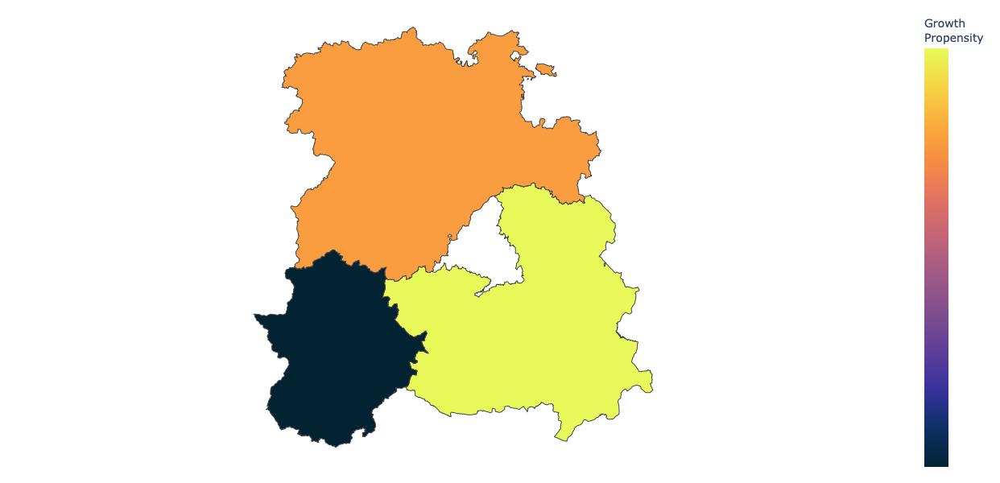

In [51]:
plot_nuts_country_hotzones("ESP", Setup.nuts2_rates_metadata, 2, "Centro (ES)")

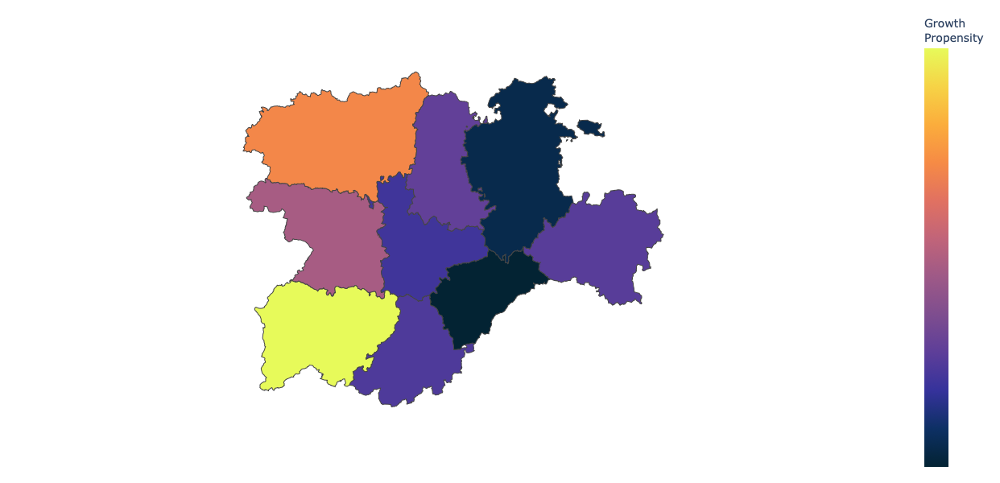

In [54]:
plot_nuts_country_hotzones("ESP", Setup.nuts3_rates_metadata, 3, "Centro (ES)", "Castilla y León")

In [63]:
import dash
from dash import dcc, html
from dash.dependencies import Input, Output
import dash_daq as daq
import plotly.express as px
import pandas as pd

# Sample DataFrame for demonstration (replace with your actual data)
df = pd.DataFrame({
    'state': ['CA', 'TX', 'NY', 'FL'],
    'Growth': [2.3, 3.1, 1.8, 2.7],
    'state_name': ['California', 'Texas', 'New York', 'Florida']
})

# Sample choropleth map function (replace this with your actual map creation logic)
def plot_usa_states_hotzones(df, show_hotzones=True):
    fig = px.choropleth(
        df,
        locations='state',
        locationmode='USA-states',
        color='Growth',
        hover_name='state_name',
        color_continuous_scale='Thermal',
        scope='usa',
    )
    if not show_hotzones:
        fig.update_traces(visible=False)  # Hide the map if not showing hot zones
    
    fig.update_layout(
        geo=dict(bgcolor='white'),
        autosize=True
    )
    return fig

# Initialize the Dash app
app = dash.Dash(__name__)

# App layout
app.layout = html.Div([
    dcc.Graph(id='map'),  # The map component

    # Div to contain the label and toggle switch inside a card
    html.Div(
        id = "toggle-switch-card",
        children = [
        html.Div([
            html.Label('Hot Zones', style={
                'font-weight': 'bold', 
                'font-size': '16px', 
                'text-align': 'center',
                'margin-bottom': '10px'  # Add space between label and switch
            }),  
            daq.ToggleSwitch(
                id='toggle-switch',
                value=False  # Default state is off (hot zones hidden)
            )
        ], style={
            'display': 'flex', 
            'flex-direction': 'column', 
            'align-items': 'center',
            'justify-content': 'center',
            'padding': '20px',
            'border-radius': '10px',
            'box-shadow': '0 4px 8px rgba(0, 0, 0, 0.1)',  # Light shadow for card effect
            'background': 'linear-gradient(135deg, #f5a3a9, #f8c2c6)',  # Light red gradient
            'width': '200px',  # Set card width
        })
    ], style={'display': 'flex', 'justify-content': 'center', 'padding': '20px'})  # Center the card
])

# Callback to update the map based on the toggle switch state
@app.callback(
    Output('map', 'figure'),  # Update the map
    Input('toggle-switch', 'value')  # Track the switch state
)
def toggle_hotzones(show_hotzones):
    # Create the map with or without hot zones
    fig = plot_usa_states_hotzones(df, show_hotzones=show_hotzones)
    return fig

# Run the Dash app
if __name__ == '__main__':
    app.run_server(debug=True)

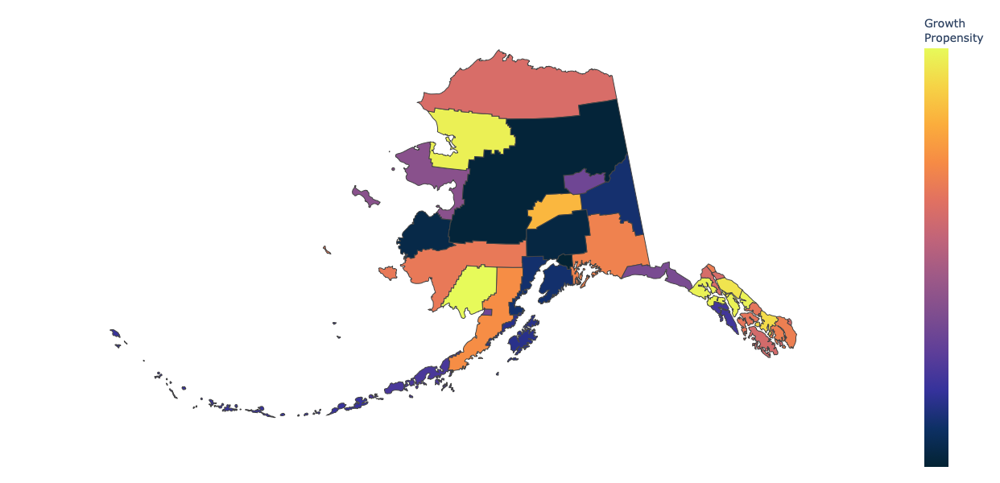

In [81]:
## How to use reference
GPlots.plot_usa_subnational_hotzones(us_counties_metadata["AK"], "AK", background_color = "white")

In [69]:
us_counties_metadata["AL"]

,fips,County,Growth
0,01001,Autauga,0.190833
1,01009,Blount,0.713926
2,01017,Chambers,0.313641
3,01021,Chilton,0.153989
4,01033,Colbert,0.495735
...,...,...,...
62,01123,Tallapoosa,0.929853
63,01127,Walker,0.341754
64,01133,Winston,0.441958
65,01043,Cullman,0.993616


In [2]:
model_type = Setup.model_type[1]
print(model_type)

image = DPlots.create_radial_graph(Setup.percentiles_full[model_type], Setup.color_hex_df, 
                                   Setup.df.iloc[0], 
                                   model_type,
                                   Setup.BACKGROUND_COLOR)
i = base64.b64decode(image)
i = io.BytesIO(i)
i = mpimg.imread(i, format='JPG')

plt.imshow(i, interpolation='nearest')
plt.show()

AttributeError: module 'Setup' has no attribute 'model_type'

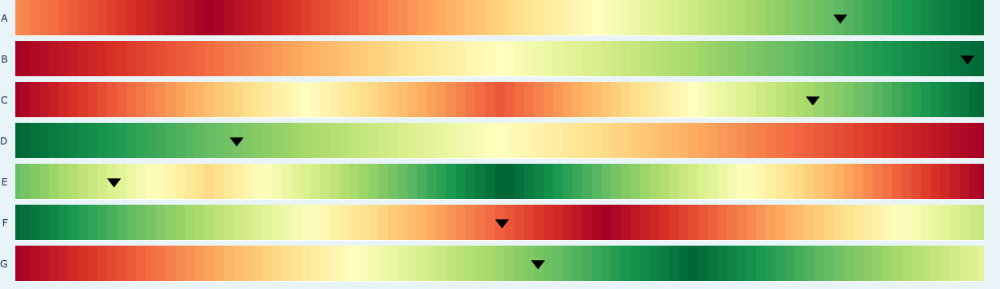

In [6]:
fig = DPlots.bar_heatmap(Setup.df.iloc[0], 
                         Setup.percentiles_full[model_type], 
                         Setup.custom_color_map_101, 
                         model_type,
                         Setup.BACKGROUND_COLOR)
fig.show()

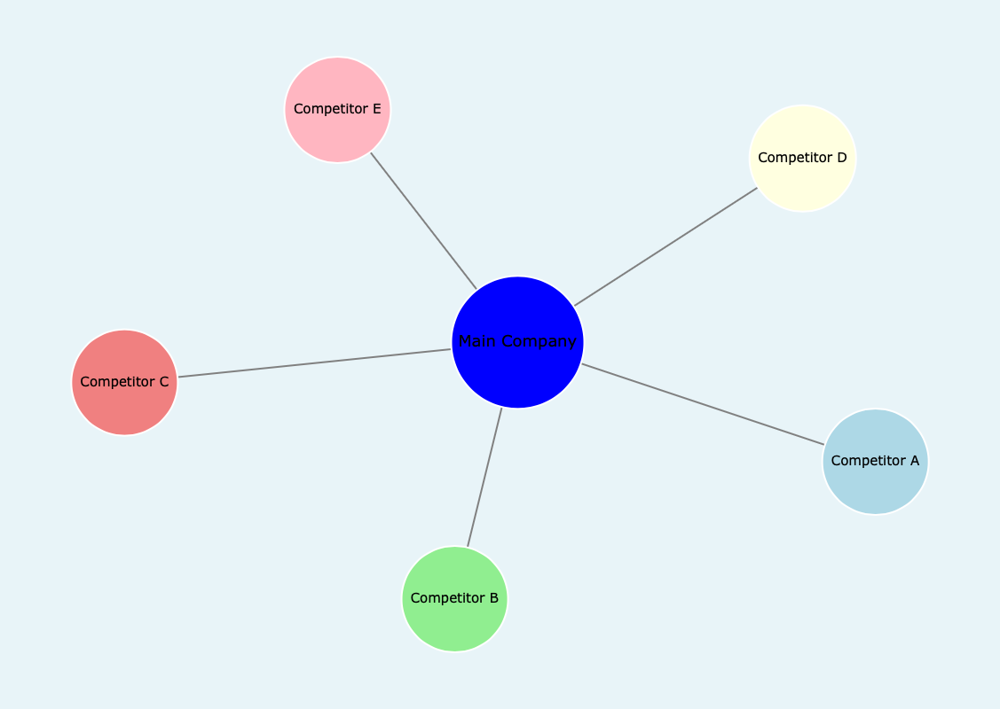

In [7]:
fig = NPlots.create_network_graph1(NPlots.network_graph1_sample_df, "Main Company", wrap_width=12, background_color=Setup.BACKGROUND_COLOR)
fig.show()

white


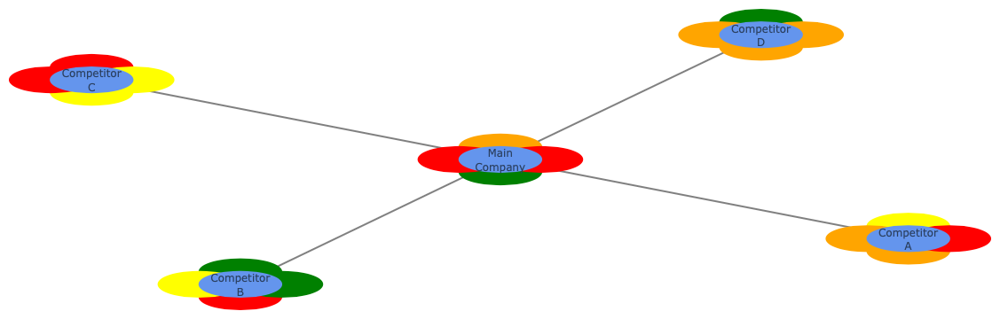

In [3]:
df = NPlots.network_data_prep(NPlots.network_graph1_sample_df, model_types=["Sales", "Asset", "Borrow", "Shrink"])

fig = NPlots.create_network_graph2(df.iloc[:5], "Main Company")
fig.show()

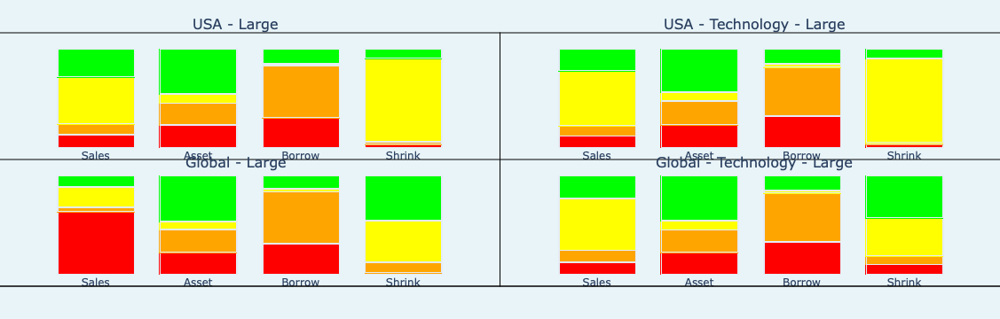

In [2]:
DMPlots.bucket_distribution(Setup.df.iloc[0],
                            country = "USA", 
                            size = "Large",
                            sector = "Technology",
                            color_dict = Setup.category_colors_labels, 
                            background_color = Setup.BACKGROUND_COLOR)

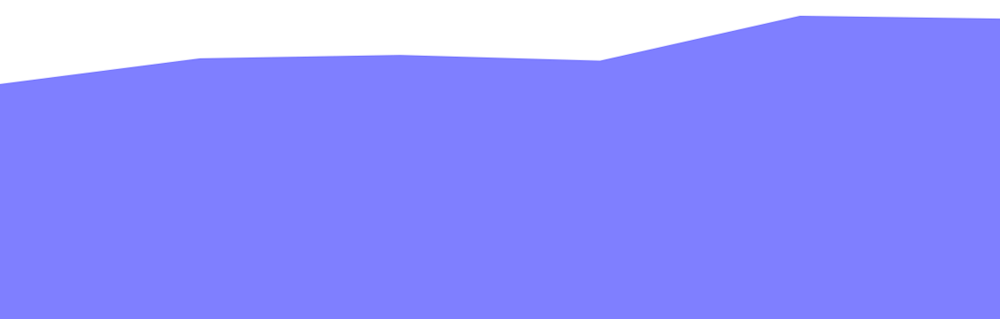

In [5]:
SPlots.create_background_line_plot(SPlots.line_plot_data_prep(Setup.df.iloc[0], model_type))

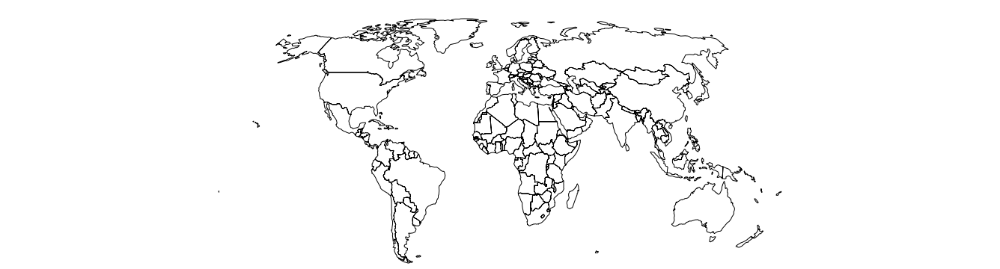

In [4]:
SPlots.create_country_silhouette("USA")

Sales


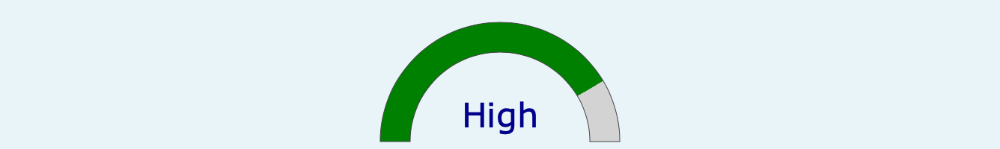

In [10]:
model_type = Setup.model_type[0]
print(model_type)
RPlots.create_radar_meter(Setup.df.iloc[10][model_type + "P"], Setup.BACKGROUND_COLOR)

Asset


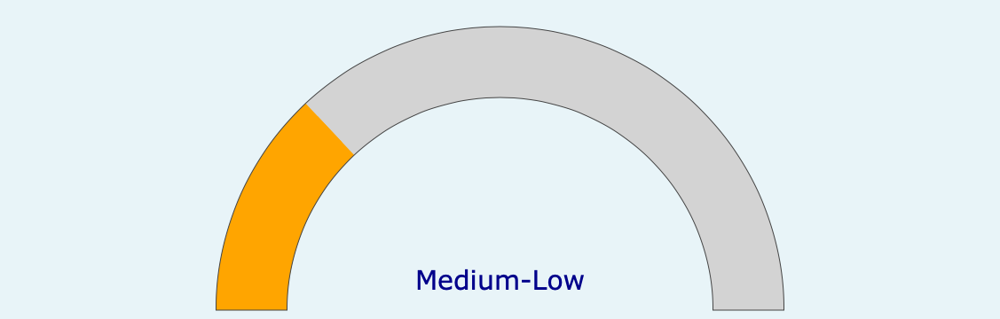

In [5]:
model_type = Setup.model_type[1]
print(model_type)
RPlots.create_radar_meter(Setup.df.iloc[20][model_type + "P"], Setup.BACKGROUND_COLOR)

Borrow


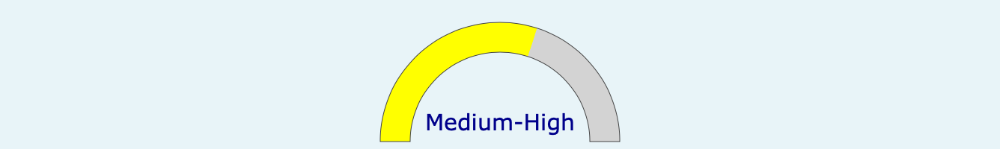

In [6]:
model_type = Setup.model_type[2]
print(model_type)
RPlots.create_radar_meter(Setup.df.iloc[12][model_type + "P"], Setup.BACKGROUND_COLOR)

Shrink


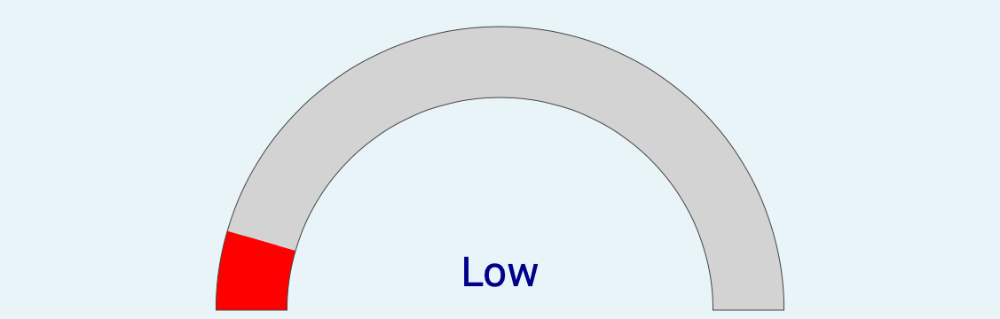

In [7]:
model_type = Setup.model_type[3]
print(model_type)
RPlots.create_radar_meter(Setup.df.iloc[18][model_type + "P"], Setup.BACKGROUND_COLOR)

In [3]:
len("Global - Consumer Services - Small")

34

In [1]:
import Setup

In [7]:
Setup.percentiles_shrink["E"].values

array([40, 39, 38, 37, 36, 35, 34, 33, 32, 31, 30, 29, 28, 27, 26, 25, 24,
       23, 22, 21, 20, 19, 18, 17, 16, 15, 14, 13, 12, 11, 10, 11, 12, 13,
       14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30,
       31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 40, 39, 38, 37, 36, 35, 34,
       33, 32, 31, 30, 29, 28, 27, 26, 25, 24, 23, 22, 21, 20, 19, 18, 17,
       16, 15, 14, 13, 12, 11, 10,  9,  8,  7,  6,  5,  4,  3,  2,  1])

In [6]:
len(Setup.percentiles_asset["E"].values)

NameError: name 'Setup' is not defined

In [2]:
import itertools


In [5]:
len(list(itertools.chain(range(90), range(70, 59, -1))))

101

In [7]:
len(range(0, 101))

101

In [9]:
len(list(itertools.chain(range(90), range(90, 79, -1))))

101

In [2]:
dmb = Setup.df

In [4]:
dmb[dmb["Names"] == "Name71"]

,Names,Sales,Asset,Sector,Country,Size,SalesP,AssetP,ShrinkP,BorrowP,...,Borrow_H_glb_size_sector,Borrow_MH_glb_size_sector,Borrow_ML_glb_size_sector,Borrow_L_glb_size_sector,Shrink_H_glb_size_sector,Shrink_MH_glb_size_sector,Shrink_ML_glb_size_sector,Shrink_L_glb_size_sector,Competitors,Industry
70,Name71,1048.444448,1965.597275,Consumer Services,USA,Small,82,40,41,37,...,538,93,2077,1234,5813,5081,1015,1077,Name11;Name48;Name86;Name28;Name13;Name92;Name...,Media


In [2]:
import pandas as pd
import numpy as np

In [18]:
growth_metadata = pd.DataFrame(
    {
        "Country" : ["USA"]*13 + ["GBR"]*13 + ["Global"]*13 + ["ESP"]*13 + ["FRA"]*13 + ["DEU"]*13 + ["ITA"]*13,
        "Sector" : ['Technology','Healthcare','Finance','Energy','Consumer Goods','Utilities','Real Estate',
                    'Telecommunications','Materials','Industrials','Consumer Services','Transportation', 'All'] * 7,
        "Count" : np.random.randint(10_000, 1_000_000, 91),
        "Growth Rate" : np.random.uniform(0,1,91)
    }
)

In [19]:
growth_metadata

,Country,Sector,Count,Growth Rate
0,USA,Technology,359383,0.106129
1,USA,Healthcare,256314,0.598173
2,USA,Finance,825222,0.760072
3,USA,Energy,761582,0.781292
4,USA,Consumer Goods,864250,0.847526
...,...,...,...,...
86,ITA,Materials,695967,0.528892
87,ITA,Industrials,607954,0.690319
88,ITA,Consumer Services,439714,0.132852
89,ITA,Transportation,572751,0.551610


In [20]:
import plotly.express as px
import numpy as np

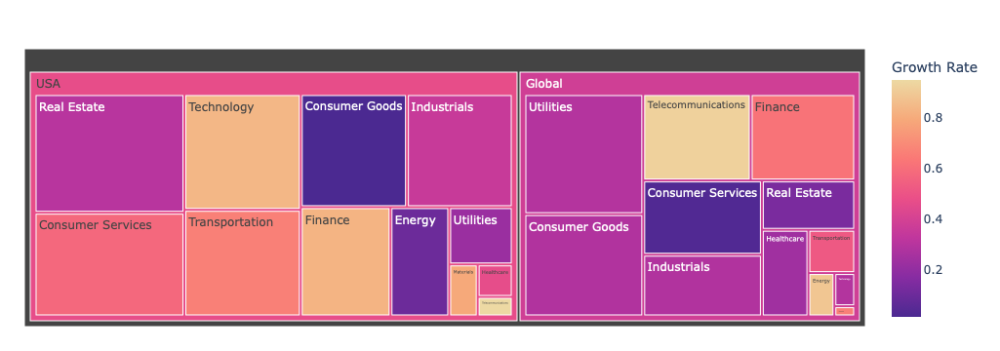

In [29]:
import plotly.express as px
import numpy as np

growth_metadata = pd.DataFrame(
    {
        "Country" : ["USA"]*13 + ["GBR"]*13 + ["Global"]*13 + ["ESP"]*13 + ["FRA"]*13 + ["DEU"]*13 + ["ITA"]*13,
        "Sector" : ['Technology','Healthcare','Finance','Energy','Consumer Goods','Utilities','Real Estate',
                    'Telecommunications','Materials','Industrials','Consumer Services','Transportation', 'All'] * 7,
        "Count" : np.random.randint(10_000, 1_000_000, 91),
        "Growth Rate" : np.random.uniform(0,1,91)
    }
)

temp = growth_metadata[(growth_metadata["Country"].isin(["USA","Global"])) & (growth_metadata["Sector"] != "All")]

fig = px.treemap(temp, path=["Country", 'Sector'], values='Count',
                  color='Growth Rate',
                  color_continuous_scale='Agsunset',
                  # color_continuous_midpoint=np.average(df['lifeExp'], weights=df['pop'])
                )
fig.update_layout(margin = dict(t=50, l=25, r=25, b=25))
fig.show()

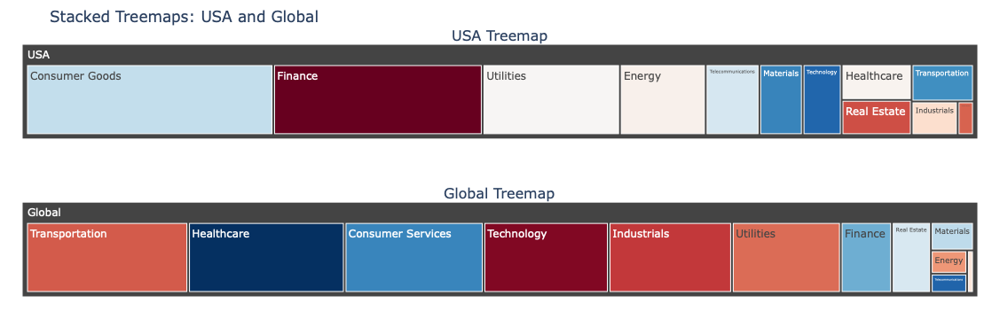

In [33]:
import plotly.graph_objects as go
import plotly.subplots as sp
import numpy as np
import pandas as pd

# Sample data
growth_metadata = pd.DataFrame({
    "Country" : ["USA"]*13 + ["GBR"]*13 + ["Global"]*13 + ["ESP"]*13 + ["FRA"]*13 + ["DEU"]*13 + ["ITA"]*13,
    "Sector" : ['Technology', 'Healthcare', 'Finance', 'Energy', 'Consumer Goods', 'Utilities', 'Real Estate',
                'Telecommunications', 'Materials', 'Industrials', 'Consumer Services', 'Transportation', 'All'] * 7,
    "Count" : np.random.randint(10_000, 1_000_000, 91),
    "Growth Rate" : np.random.uniform(0, 1, 91)
})

# Filter data for "USA" and "Global" branches excluding the "All" sector
usa_data = growth_metadata[(growth_metadata["Country"] == "USA") & (growth_metadata["Sector"] != "All")]
global_data = growth_metadata[(growth_metadata["Country"] == "Global") & (growth_metadata["Sector"] != "All")]

# Create the subplot layout with 'domain' type
fig = sp.make_subplots(rows=2, cols=1, 
                       specs=[[{"type": "domain"}], [{"type": "domain"}]],  # Set to domain for treemaps
                       subplot_titles=("USA Treemap", "Global Treemap"))

# Treemap for USA
fig.add_trace(
    go.Treemap(
        labels=usa_data['Sector'],
        parents=[f"USA"] * len(usa_data),
        values=usa_data['Count'],
        marker=dict(
            colors=usa_data['Growth Rate'],
            colorscale='RdBu',
            cmid=usa_data["Growth Rate"].mean()  # Midpoint for USA
        ),
        name="USA"
    ), 
    row=1, col=1
)

# Treemap for Global
fig.add_trace(
    go.Treemap(
        labels=global_data['Sector'],
        parents=[f"Global"] * len(global_data),
        values=global_data['Count'],
        marker=dict(
            colors=global_data['Growth Rate'],
            colorscale='RdBu',
            cmid=global_data["Growth Rate"].mean()  # Midpoint for Global
        ),
        name="Global"
    ), 
    row=2, col=1
)

# Update layout to manage margins and styling
fig.update_layout(
    title="Stacked Treemaps: USA and Global",
    margin=dict(t=50, l=25, r=25, b=25)
)

# Show the figure
fig.show()


In [2]:
growth_metadata[growth_metadata["Sector"] == "All"]#.iloc[0]["Growth Rate"]

,Country,Sector,Count,Growth Rate
12,USA,All,383615,0.173082
25,GBR,All,649833,0.296420
38,Global,All,252825,0.387425
51,ESP,All,47528,0.731273
64,FRA,All,28601,0.944145
77,DEU,All,307595,0.142804
90,ITA,All,16445,0.076778


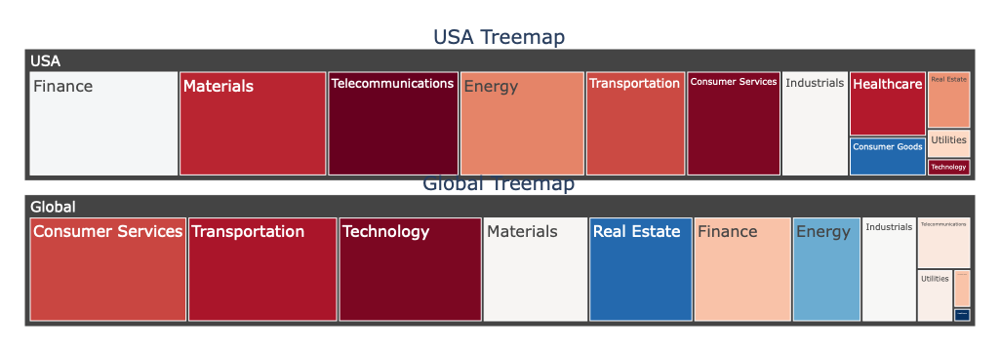

In [47]:
import plotly.graph_objects as go
import plotly.subplots as sp
import numpy as np
import pandas as pd

# Sample data
growth_metadata = pd.DataFrame({
    "Country" : ["USA"]*13 + ["GBR"]*13 + ["Global"]*13 + ["ESP"]*13 + ["FRA"]*13 + ["DEU"]*13 + ["ITA"]*13,
    "Sector" : ['Technology', 'Healthcare', 'Finance', 'Energy', 'Consumer Goods', 'Utilities', 'Real Estate',
                'Telecommunications', 'Materials', 'Industrials', 'Consumer Services', 'Transportation', 'All'] * 7,
    "Count" : np.random.randint(10_000, 1_000_000, 91),
    "Growth Rate" : np.random.uniform(0, 1, 91)
})

# Filter data for "USA" and "Global" branches excluding the "All" sector
usa_data = growth_metadata[(growth_metadata["Country"] == "USA") & (growth_metadata["Sector"] != "All")]
global_data = growth_metadata[(growth_metadata["Country"] == "Global") & (growth_metadata["Sector"] != "All")]

# Create the subplot layout with 'domain' type
fig = sp.make_subplots(rows=2, cols=1, 
                       specs=[[{"type": "domain"}], [{"type": "domain"}]],  # Set to domain for treemaps
                       vertical_spacing=0.05,  # Reduce vertical spacing between the subplots
                       subplot_titles=("USA Treemap", "Global Treemap"))

# Treemap for USA
fig.add_trace(
    go.Treemap(
        labels=usa_data['Sector'],
        parents=[f"USA"] * len(usa_data),
        values=usa_data['Count'],
        marker=dict(
            colors=usa_data['Growth Rate'],
            colorscale='RdBu',
            cmid=growth_metadata[(growth_metadata["Country"] == "USA") & (growth_metadata["Sector"] == "All")].iloc[0]["Growth Rate"]  # Midpoint for USA
        ),
        name="USA",
        textinfo="label",  # Show labels and values
        insidetextfont=dict(size=16),  # Set font size for better readability
        tiling=dict(pad=3),  # Add padding to improve space between tiles
        texttemplate="%{label}",  # Ensure label + value are on different lines
        pathbar_textfont=dict(size=12)  # Adjust font size of path bar for better readability
    ), 
    row=1, col=1
)

# Treemap for Global
fig.add_trace(
    go.Treemap(
        labels=global_data['Sector'],
        parents=[f"Global"] * len(global_data),
        values=global_data['Count'],
        marker=dict(
            colors=global_data['Growth Rate'],
            colorscale='RdBu',
            cmid=growth_metadata[(growth_metadata["Country"] == "Global") & (growth_metadata["Sector"] == "All")].iloc[0]["Growth Rate"]  # Midpoint for Global
        ),
        name="Global",
        textinfo="label",  # Show labels and values
        insidetextfont=dict(size=16),  # Set font size for better readability
        tiling=dict(pad=3),  # Add padding to improve space between tiles
        texttemplate="%{label}",  # Ensure label + value are on different lines
        pathbar_textfont=dict(size=12)  # Adjust font size of path bar for better readability
    ), 
    row=2, col=1
)

# Update layout to manage margins and styling
fig.update_layout(
    margin=dict(t=50, l=25, r=25, b=25),
    height=900  # Adjust height to make space for readability
)

fig.update_annotations(font_size=20)


# Show the figure
fig.show()


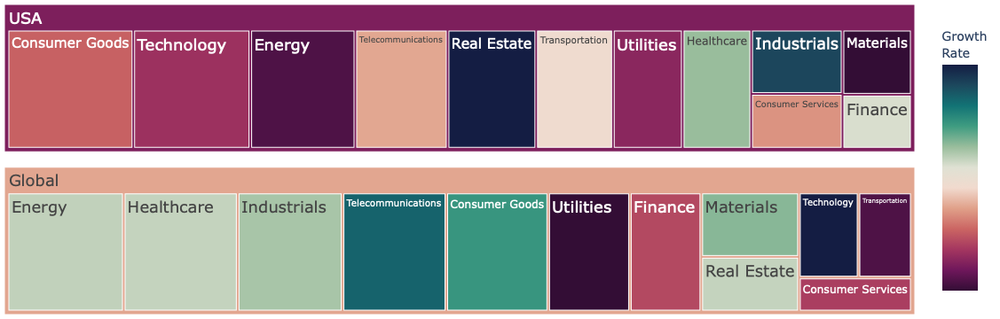

In [1]:
import numpy as np
import pandas as pd
import plotly.graph_objects as go
from plotly.subplots import make_subplots
import plotly.express as px

import Tree_Plots

growth_metadata = pd.DataFrame(
    {
        "Country" : ["USA"]*13 + ["GBR"]*13 + ["Global"]*13 + ["ESP"]*13 + ["FRA"]*13 + ["DEU"]*13 + ["ITA"]*13,
        "Sector" : ['Technology','Healthcare','Finance','Energy','Consumer Goods','Utilities','Real Estate',
                    'Telecommunications','Materials','Industrials','Consumer Services','Transportation', 'All'] * 7,
        "Count" : np.random.randint(10_000, 1_000_000, 91),
        "Growth Rate" : np.random.uniform(0,1,91)
    }
)

cntry = "USA"

cntry_data = growth_metadata[(growth_metadata["Country"] == cntry) & (growth_metadata["Sector"] != "All")].copy()
cntry_all = growth_metadata[(growth_metadata["Country"] == cntry) & (growth_metadata["Sector"] == "All")].iloc[0]["Growth Rate"]

glb_data = growth_metadata[(growth_metadata["Country"] == "Global") & (growth_metadata["Sector"] != "All")].copy()
glb_all = growth_metadata[(growth_metadata["Country"] == "Global") & (growth_metadata["Sector"] == "All")].iloc[0]["Growth Rate"]

Tree_Plots.combined_tree_sector_plot(cntry_data, glb_data, 
                                     cntry_all, glb_all, 
                                     "Country", "Count", "Sector", "Growth Rate", normalize = True, background_color = "white")


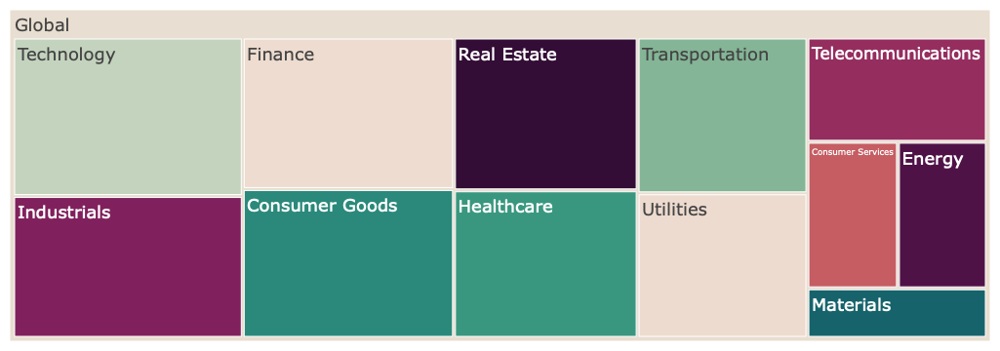

In [10]:
Tree_Plots.tree_sector_plot(glb_data, glb_all,
                            "Country", "Count", "Sector", 
                            "Growth Rate", normalize = True, 
                            background_color = "white", show_colorbar = True)

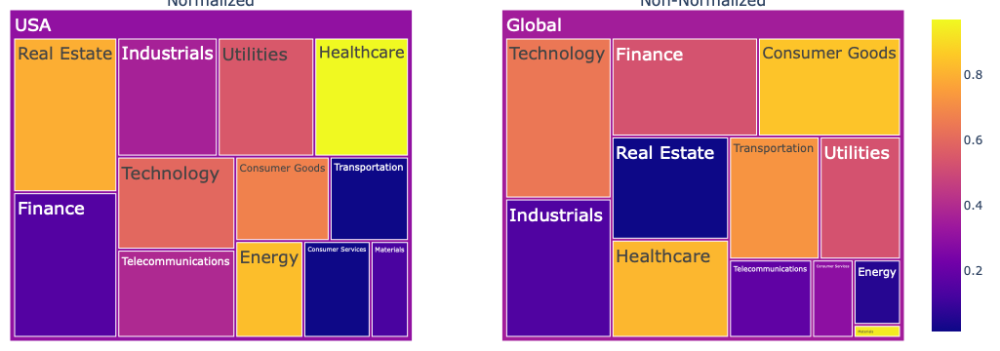

In [11]:
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots

# Function to create a treemap
def create_treemap(df, country_col, sector_col, count_col, rate_col, glb_all, normalize=False, show_colorbar=True):
    if normalize:
        # Standardize the count column
        mean_value = df[count_col].mean()
        std_value = df[count_col].std()
        df['Standardized Count'] = (df[count_col] - mean_value) / std_value  # Standardize
        df['Standardized Count'] = df['Standardized Count'] - df['Standardized Count'].min() + 1

        fig = px.treemap(
            df,
            path=[country_col, sector_col],
            values="Standardized Count",
            color=rate_col,
            color_continuous_scale="curl_r",
            color_continuous_midpoint=glb_all
        )

    else:
        fig = px.treemap(
            df,
            path=[country_col, sector_col],
            values=count_col,
            color=rate_col,
            color_continuous_scale="curl_r",
            color_continuous_midpoint=glb_all
        )

    # Manually set color to overall rate for last color
    fig.data[0]["marker"]["colors"][-1] = glb_all

    fig.update_traces(
        hovertemplate="<b>%{label}</b><br>Growth Rate: %{color:.2f}",  # Custom hover text
        textinfo="label",  # Display label only
        insidetextfont=dict(size=18),
        marker=dict(pad=dict(t=30, l=5, r=5, b=5))  # Padding for readability
    )

    # Conditionally show or hide the color bar, while maintaining the colors
    if not show_colorbar:
        fig.update_coloraxes(showscale=False)  # Hide the color bar but keep the color scale

    return fig

# Example function to combine two treemaps in subplots
def create_combined_treemap(df1, df2, country_col, sector_col, count_col, rate_col, glb_all):
    # Create the first treemap (normalized), with the color bar shown
    fig1 = create_treemap(df1, country_col, sector_col, count_col, rate_col, glb_all, normalize=True, show_colorbar=True)

    # Create the second treemap (non-normalized), hiding the color bar but maintaining colors
    fig2 = create_treemap(df2, country_col, sector_col, count_col, rate_col, glb_all, normalize=False, show_colorbar=False)

    # Combine both figures into a single figure with subplots using 'domain' type for treemaps
    fig_combined = make_subplots(
        rows=1, cols=2,
        subplot_titles=("Normalized", "Non-Normalized"),
        specs=[[{'type': 'domain'}, {'type': 'domain'}]]  # Specify domain type for treemaps
    )

    # Add the first treemap to the combined figure (with color bar)
    fig_combined.add_traces(fig1.data, rows=1, cols=1)

    # Add the second treemap to the combined figure (without color bar, but with colors)
    fig_combined.add_traces(fig2.data, rows=1, cols=2)

    # Update layout for better spacing
    fig_combined.update_layout(
        margin=dict(t=10, l=10, r=10, b=10),  # Reduce margins
        plot_bgcolor='white',
        paper_bgcolor='white'
    )

    return fig_combined


# Assuming df1 and df2 are defined
# Example call to combine two treemaps
fig = create_combined_treemap(cntry_data, glb_data, 'Country', 'Sector', 'Count', 'Growth Rate', 0.35)
fig.show()

In [7]:
import numpy as np
import pandas as pd
import plotly.graph_objects as go
from plotly.subplots import make_subplots
import plotly.express as px

In [69]:
growth_metadata = pd.DataFrame(
    {
        "Country" : ["USA"]*13 + ["GBR"]*13 + ["Global"]*13 + ["ESP"]*13 + ["FRA"]*13 + ["DEU"]*13 + ["ITA"]*13,
        "Sector" : ['Technology','Healthcare','Finance','Energy','Consumer Goods','Utilities','Real Estate',
                    'Telecommunications','Materials','Industrials','Consumer Services','Transportation', 'All'] * 7,
        "Count" : np.random.randint(10_000, 1_000_000, 91),
        "Growth Rate" : np.random.uniform(0,1,91)
    }
)

In [70]:
cntry = "USA"

cntry_data = growth_metadata[(growth_metadata["Country"] == cntry) & (growth_metadata["Sector"] != "All")].copy()
cntry_all = growth_metadata[(growth_metadata["Country"] == cntry) & (growth_metadata["Sector"] == "All")].iloc[0]["Growth Rate"]

glb_data = growth_metadata[(growth_metadata["Country"] == "Global") & (growth_metadata["Sector"] != "All")].copy()
glb_all = growth_metadata[(growth_metadata["Country"] == "Global") & (growth_metadata["Sector"] == "All")].iloc[0]["Growth Rate"]


mean_value = glb_data['Count'].mean()
std_value = glb_data['Count'].std()
glb_data['Standardized Count'] = (glb_data['Count'] - mean_value) / std_value  # Standardize
# Shift the values to make them all positive (since treemap values can't be negative)
glb_data['Standardized Count'] = glb_data['Standardized Count'] - glb_data['Standardized Count'].min() + 1

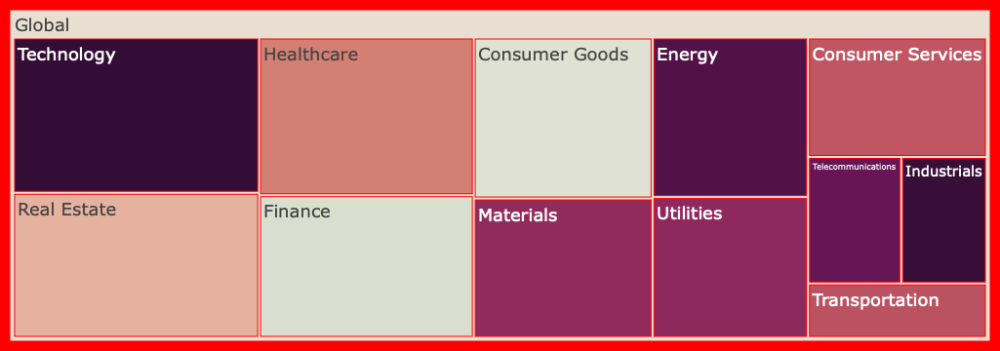

In [85]:
fig = px.treemap(
    glb_data,
    path = ["Country", "Sector"],
    values = "Standardized Count",
    color = "Growth Rate",
    color_continuous_scale = "curl_r",
    color_continuous_midpoint = glb_all
)

# Manually set color to overall rate
fig.data[0]["marker"]["colors"][-1] = glb_all

# fig.update_layout(
#     uniformtext=dict(minsize=15, mode='show'),  # Set minimum font size to 10, ensure all text is shown
#     margin=dict(t=50, l=25, r=25, b=25)  # Adjust margins
# )

fig.update_traces(
    hovertemplate="<b>%{label}</b><br>Growth Rate: %{color:.2f}",  # Custom hover text
    textinfo="label",  # Keep text in the boxes
    insidetextfont=dict(size=18),
    marker=dict(pad=dict(t=30, l=5, r=5, b=5))  # Padding for better readability
)

fig.update_coloraxes(showscale=False)

fig.update_layout(
    margin=dict(t=10, l=10, r=10, b=10),  # Reduce margins to 10px on all sides
    plot_bgcolor="red",
        paper_bgcolor="red"
)

fig.show()

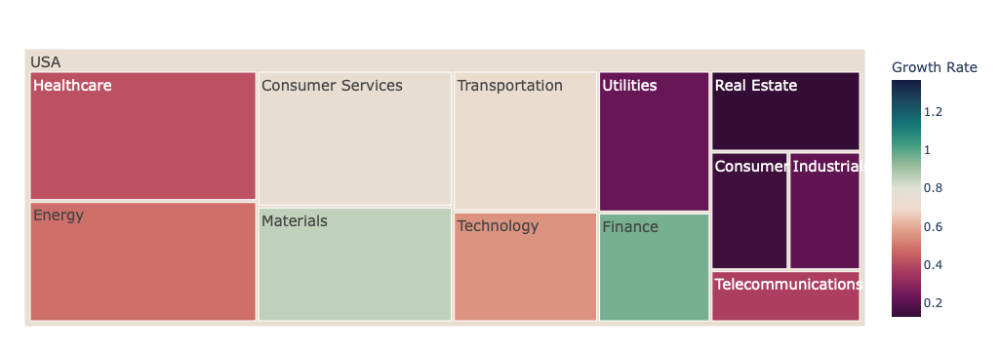

In [72]:
mean_value = cntry_data['Count'].mean()
std_value = cntry_data['Count'].std()
cntry_data['Standardized Count'] = (cntry_data['Count'] - mean_value) / std_value  # Standardize
# Shift the values to make them all positive (since treemap values can't be negative)
cntry_data['Standardized Count'] = cntry_data['Standardized Count'] - cntry_data['Standardized Count'].min() + 1

fig = px.treemap(
    cntry_data,
    path = ["Country", "Sector"],
    values = "Standardized Count",
    color = "Growth Rate",
    color_continuous_scale = "curl_r",
    color_continuous_midpoint = cntry_all
)

# Manually set color to overall rate
fig.data[0]["marker"]["colors"][-1] = cntry_all

fig.update_layout(
    uniformtext=dict(minsize=15, mode='show'),  # Set minimum font size to 10, ensure all text is shown
    margin=dict(t=50, l=25, r=25, b=25)  # Adjust margins
)

# fig.update_coloraxes(showscale=False)

fig.show()

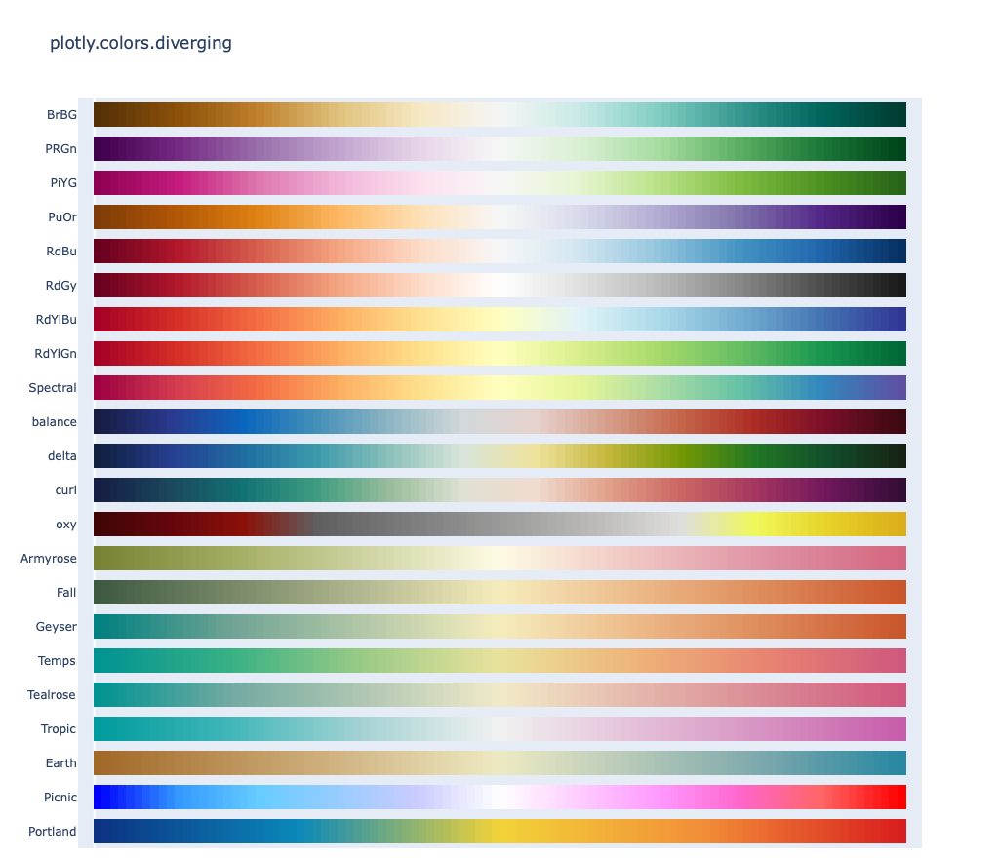

In [90]:
fig = px.colors.diverging.swatches_continuous()
fig.show()

In [94]:
fig.data[10]

Bar({
    'customdata': [0.01, 0.02, 0.03, 0.04, 0.05, 0.06, 0.07, 0.08, 0.09, 0.1,
                   0.11, 0.12, 0.13, 0.14, 0.15, 0.16, 0.17, 0.18, 0.19, 0.2, 0.21,
                   0.22, 0.23, 0.24, 0.25, 0.26, 0.27, 0.28, 0.29, 0.3, 0.31, 0.32,
                   0.33, 0.34, 0.35, 0.36, 0.37, 0.38, 0.39, 0.4, 0.41, 0.42, 0.43,
                   0.44, 0.45, 0.46, 0.47, 0.48, 0.49, 0.5, 0.51, 0.52, 0.53, 0.54,
                   0.55, 0.56, 0.57, 0.58, 0.59, 0.6, 0.61, 0.62, 0.63, 0.64, 0.65,
                   0.66, 0.67, 0.68, 0.69, 0.7, 0.71, 0.72, 0.73, 0.74, 0.75, 0.76,
                   0.77, 0.78, 0.79, 0.8, 0.81, 0.82, 0.83, 0.84, 0.85, 0.86, 0.87,
                   0.88, 0.89, 0.9, 0.91, 0.92, 0.93, 0.94, 0.95, 0.96, 0.97, 0.98,
                   0.99, 1.0],
    'hovertemplate': '%{customdata}',
    'marker': {'color': [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16,
                         17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30,
           

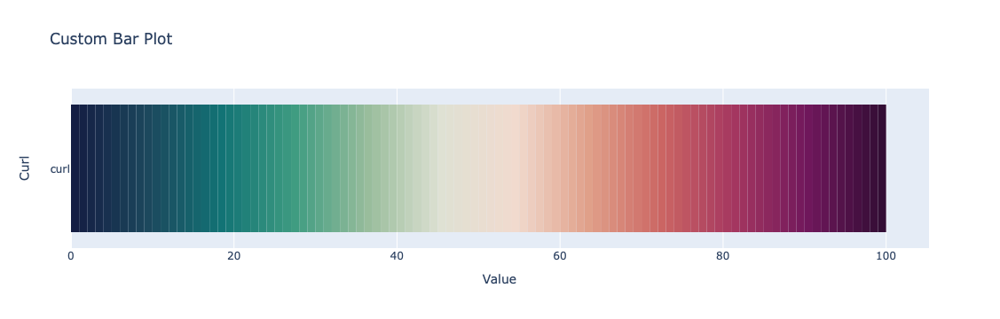

In [3]:
import plotly.graph_objects as go

# Define custom colorscale
colorscale = [
    [0.0, 'rgb(20, 29, 67)'],
    [0.09090909090909091, 'rgb(28, 72, 93)'],
    [0.18181818181818182, 'rgb(18, 115, 117)'],
    [0.2727272727272727, 'rgb(63, 156, 129)'],
    [0.36363636363636365, 'rgb(153, 189, 156)'],
    [0.45454545454545453, 'rgb(223, 225, 211)'],
    [0.5454545454545454, 'rgb(241, 218, 206)'],
    [0.6363636363636364, 'rgb(224, 160, 137)'],
    [0.7272727272727273, 'rgb(203, 101, 99)'],
    [0.8181818181818182, 'rgb(164, 54, 96)'],
    [0.9090909090909091, 'rgb(111, 23, 91)'],
    [1.0, 'rgb(51, 13, 53)']
]

# Custom data
customdata = [round(i, 2) for i in [x / 100 for x in range(1, 101)]]

# Marker colors
marker_color = list(range(100))

# X values (all set to 1 for a horizontal bar)
x_values = [1] * 100

# Create the bar chart
fig = go.Figure(go.Bar(
    x=x_values,
    y=['curl'] * 100,  # All y values are set to 'curl'
    customdata=customdata,
    orientation='h',
    marker=dict(
        color=marker_color,
        colorscale=colorscale,
        line=dict(width=0)
    ),
    hovertemplate='%{customdata}',  # Use the custom data for hover
    name="curl"
))

# Update layout
fig.update_layout(
    title="Custom Bar Plot",
    xaxis_title="Value",
    yaxis_title="Curl",
    showlegend=False
)

# Show the plot
fig.show()


In [4]:
fig.data

(Bar({
     'customdata': [0.01, 0.02, 0.03, 0.04, 0.05, 0.06, 0.07, 0.08, 0.09, 0.1,
                    0.11, 0.12, 0.13, 0.14, 0.15, 0.16, 0.17, 0.18, 0.19, 0.2, 0.21,
                    0.22, 0.23, 0.24, 0.25, 0.26, 0.27, 0.28, 0.29, 0.3, 0.31, 0.32,
                    0.33, 0.34, 0.35, 0.36, 0.37, 0.38, 0.39, 0.4, 0.41, 0.42, 0.43,
                    0.44, 0.45, 0.46, 0.47, 0.48, 0.49, 0.5, 0.51, 0.52, 0.53, 0.54,
                    0.55, 0.56, 0.57, 0.58, 0.59, 0.6, 0.61, 0.62, 0.63, 0.64, 0.65,
                    0.66, 0.67, 0.68, 0.69, 0.7, 0.71, 0.72, 0.73, 0.74, 0.75, 0.76,
                    0.77, 0.78, 0.79, 0.8, 0.81, 0.82, 0.83, 0.84, 0.85, 0.86, 0.87,
                    0.88, 0.89, 0.9, 0.91, 0.92, 0.93, 0.94, 0.95, 0.96, 0.97, 0.98,
                    0.99, 1.0],
     'hovertemplate': '%{customdata}',
     'marker': {'color': [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16,
                          17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 3

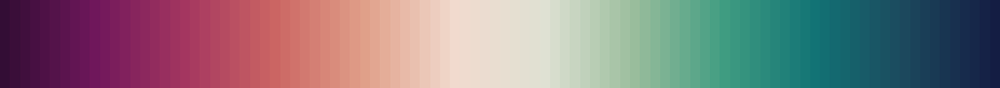

In [114]:
import plotly.graph_objects as go
import plotly.express as px
import numpy as np

# Define the color scale using curl_r from Plotly's diverging color scales
colors = px.colors.diverging.curl_r

# Zip the colors with evenly spaced numbers between 0 and 1 to create the color scale
custom_color_scale = list(zip(np.linspace(0, 1, len(colors)), colors))

# Create a figure with a single-row heatmap to represent the color scale
fig = go.Figure()

# Use a 2D array for `z`, where each value corresponds to a different color
fig.add_trace(go.Heatmap(
    z=[np.linspace(0, 1, 100)],  # A single row with values from 0 to 1
    colorscale=custom_color_scale,  # Use the custom color scale
    showscale=False  # Hide the default color bar
))

# Adjust layout to make the plot look like a continuous color bar
fig.update_layout(
    xaxis=dict(visible=False),  # Hide x-axis
    yaxis=dict(visible=False),  # Hide y-axis
    margin=dict(t=0, b=0, l=0, r=0),  # Minimal margins
    height=100,  # Set the height for the color bar
    width=800  # Set the width for the color bar
)

# Show the figure
fig.show()


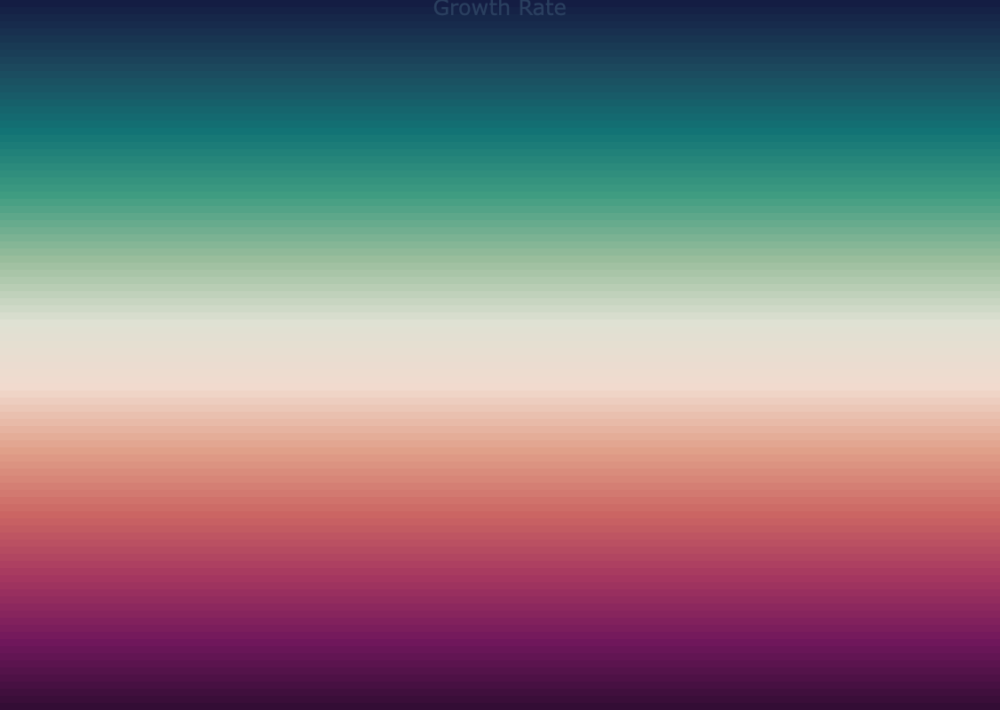

In [14]:
import plotly.graph_objects as go
import plotly.express as px
import numpy as np

# Define the color scale using curl_r from Plotly's diverging color scales
colors = px.colors.diverging.curl_r

# Zip the colors with evenly spaced numbers between 0 and 1 to create the color scale
custom_color_scale = list(zip(np.linspace(0, 1, len(colors)), colors))

# Create a figure with a single-column heatmap to represent the color scale
fig = go.Figure()

# Use a 2D array for `z`, where each value corresponds to a different color
fig.add_trace(go.Heatmap(
    z=np.linspace(0, 1, 100).reshape(100, 1),  # A single column with values from 0 to 1
    colorscale=custom_color_scale,  # Use the custom color scale
    showscale=False,  # Hide the default color bar
    hoverinfo='none'  # Disable hover interaction
))

# Adjust layout to make the plot look like a vertical color bar and remove margins/whitespace
fig.update_layout(
    title=dict(
        text="Growth Rate",  # Add the title text
        y=1,  # Position the title just above the plot (adjust this as needed)
        x=0.5,  # Center the title
        xanchor='center',
        yanchor='top',
        font=dict(size=24)  # Adjust the font size of the title
    ),
    xaxis=dict(visible=False, showgrid=False, zeroline=False),  # Hide x-axis completely
    yaxis=dict(visible=False, showgrid=False, zeroline=False),  # Hide y-axis completely
    margin=dict(t=0, b=0, l=0, r=0),  # Remove all margins to eliminate whitespace
    height=800,  # Set the height for the vertical color bar
    width=100,   # Set the width for the vertical color bar
    autosize=False,  # Disable autosize
    paper_bgcolor='rgba(0,0,0,0)',  # Make background completely transparent
    plot_bgcolor='rgba(0,0,0,0)'    # Make plot area background completely transparent
)

# Use static plot mode to disable interactions
fig.show(config={'staticPlot': True})

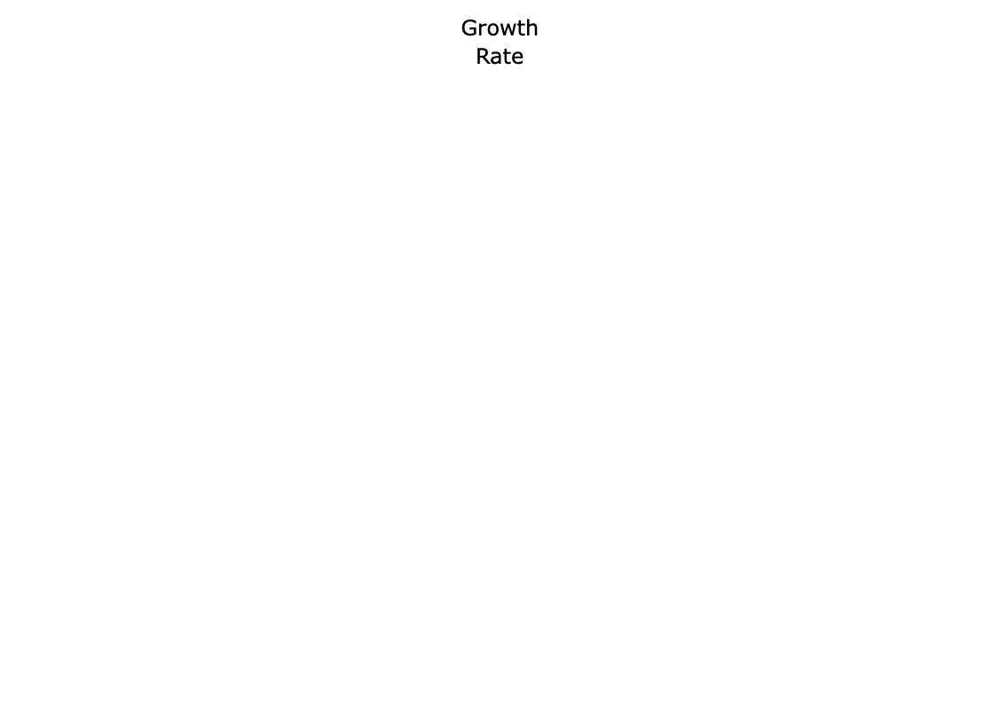

In [30]:
import plotly.graph_objects as go
import plotly.express as px
import numpy as np

# Define the color scale using curl_r from Plotly's diverging color scales
colors = px.colors.diverging.curl_r

# Zip the colors with evenly spaced numbers between 0 and 1 to create the color scale
custom_color_scale = list(zip(np.linspace(0, 1, len(colors)), colors))

# Create a figure with a single-column heatmap to represent the color scale
fig = go.Figure()

# Use a 2D array for `z`, where each value corresponds to a different color
fig.add_trace(go.Heatmap(
    z=np.linspace(0, 1, 100).reshape(100, 1),  # A single column with values from 0 to 1
    colorscale=custom_color_scale,  # Use the custom color scale
    showscale=False,  # Hide the default color bar
    hoverinfo='none'  # Disable hover interaction
))

# Adjust layout to make the plot look like a vertical color bar and remove margins/whitespace
fig.update_layout(
    title=dict(
        text="Growth<br>Rate",  # Title text
        y=0.95,  # Position above the plot
        x=0.5,  # Center the title horizontally
        xanchor="center",
        yanchor="top",
        font=dict(size=24, color = "black"),  # Set title font size
    ),
    xaxis=dict(visible=False, showgrid=False, zeroline=False),  # Hide x-axis completely
    yaxis=dict(visible=False, showgrid=False, zeroline=False),  # Hide y-axis completely
    margin=dict(t=80, b=0, l=0, r=0),  # Increased top margin for title
    height=800,  # Set the height for the vertical color bar
    width=100,   # Set the width for the vertical color bar
    autosize=False,  # Disable autosize
    paper_bgcolor='rgba(0,0,0,0)',  # Make background completely transparent
    plot_bgcolor='rgba(0,0,0,0)'    # Make plot area background completely transparent
)

# Use static plot mode to disable interactions
fig.show()


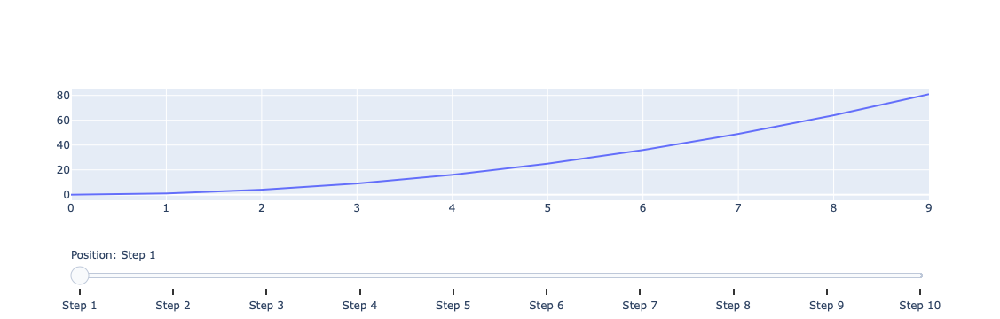

In [3]:
import plotly.graph_objects as go

# Sample data
x = list(range(10))
y = [i**2 for i in x]

# Create a figure
fig = go.Figure()

# Add static data
fig.add_trace(go.Scatter(x=x, y=y, mode='lines', name='Line Plot'))

# Add a static slider (it won't affect the graph data)
fig.update_layout(
    sliders=[
        {
            "active": 0,
            "currentvalue": {"prefix": "Position: "},
            "pad": {"t": 50},
            "steps": [
                {"label": f"Step {i}", "method": "update", "args": [{"visible": [True]}]} for i in range(1, 11)
            ],
        }
    ]
)

# Show the plot
fig.show()


In [5]:

rc

,A_RC,B_RC,C_RC,D_RC,E_RC,F_RC,G_RC
0,0.1,0.2,0.3,0.05,0.15,0.07,0.03


In [6]:
categories = {"A" : "Profitability",
             "B": "Profitability",
             "C":"Leverage",
             "D":"Liquidity",
             "E":"Liquidity",
             "F" : "Grow",
              "G" : "Grow"
}

['A', 'B', 'C', 'D', 'E', 'F', 'G']

In [21]:
import pandas as pd
rc = pd.DataFrame({
    "A_RC" : [0.1],
    "B_RC" : [0.2],
    "C_RC" : [0.3],
    "D_RC" : [0.05],
    "E_RC" : [0.15],
    "F_RC" : [0.07],
    "G_RC" : [0.03],
})

rc = rc.transpose().rename(columns = {0:"RC"})
rc["var"] = [i.replace("_RC", "") for i in rc.index.values]
rc["category"] = rc["var"].map(categories)
rc["out"] = "green"
rc

,RC,var,category,out
A_RC,0.10,A,Profitability,green
B_RC,0.20,B,Profitability,green
C_RC,0.30,C,Leverage,green
D_RC,0.05,D,Liquidity,green
E_RC,0.15,E,Liquidity,green
F_RC,0.07,F,Grow,green
G_RC,0.03,G,Grow,green


        RC var    category    out
A_RC  0.10   A  Category 1  green
B_RC  0.20   B  Category 1  green
C_RC  0.30   C  Category 2  green
E_RC  0.15   E  Category 2  green
D_RC  0.05   D  Category 3  green
F_RC  0.07   F  Category 3  green
G_RC  0.03   G  Category 3  green


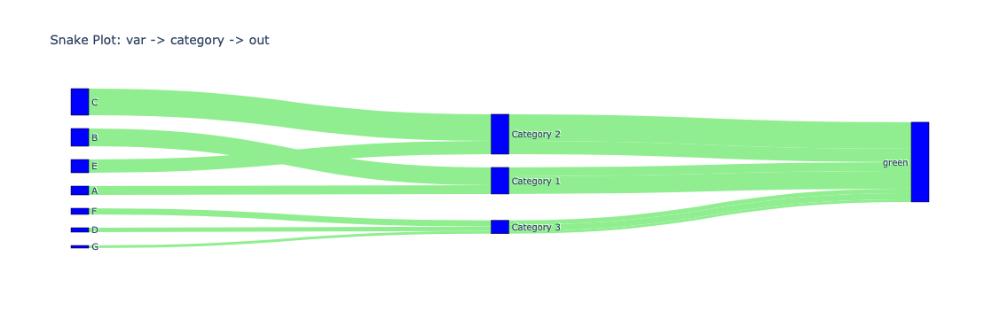

In [55]:
import pandas as pd
import plotly.graph_objects as go

# Sample categories for var
categories = {
    "A": "Category 1",
    "B": "Category 1",
    "C": "Category 2",
    "D": "Category 3",
    "E": "Category 2",
    "F": "Category 3",
    "G": "Category 3"
}

# Your data
rc = pd.DataFrame({
    "A_RC" : [0.1],
    "B_RC" : [0.2],
    "C_RC" : [0.3],
    "D_RC" : [0.05],
    "E_RC" : [0.15],
    "F_RC" : [0.07],
    "G_RC" : [0.03],
})

# Prepare the dataframe
rc = rc.transpose().rename(columns={0: "RC"})
rc["var"] = [i.replace("_RC", "") for i in rc.index.values]
rc["category"] = rc["var"].map(categories)
rc["out"] = "green"

rc = rc.sort_values("category")
print(rc)

# Create unique labels for sankey nodes (var, category, and out)
all_labels = list(rc["var"].unique()) + list(rc["category"].unique()) + ["green"]

# Define the Sankey diagram flow from var -> category -> out
sources = list(rc["var"].apply(lambda x: all_labels.index(x)))  # Indices of var
targets = list(rc["category"].apply(lambda x: all_labels.index(x)))  # Indices of category
out_targets = [all_labels.index("green")] * len(rc["category"])  # 'green' as the final node

# Combine the flows: var -> category and category -> out
sources += targets
targets += out_targets

# The values represent the RC values for the flows
values = list(rc["RC"]) + list(rc["RC"])

# Create the Sankey plot
fig = go.Figure(go.Sankey(
    node=dict(
        pad=15,
        thickness=20,
        line=dict(color="black", width=0.5),
        label=all_labels,  # All unique labels (var, category, out)
        color="blue"  # Color for the nodes
    ),
    link=dict(
        source=sources,  # Flows from var -> category and category -> out
        target=targets,
        value=values,
        color="lightgreen"  # Color for the flow links
    )
))

# Set the layout title and display the plot
fig.update_layout(title_text="Snake Plot: var -> category -> out", font_size=10)
fig.show()

In [23]:
sources

[0, 1, 2, 3, 4, 5, 6, 7, 7, 8, 9, 8, 9, 9]

In [24]:
targets

[7, 7, 8, 9, 8, 9, 9, 10, 10, 10, 10, 10, 10, 10]

In [39]:
rc

,RC,var,category,out
A_RC,0.10,A,Category 1,green
B_RC,0.20,B,Category 1,green
C_RC,0.30,C,Category 2,green
D_RC,0.05,D,Category 3,green
E_RC,0.15,E,Category 2,green
F_RC,0.07,F,Category 3,green
G_RC,0.03,G,Category 3,green


In [85]:
ap = SankeyData_Plotly(rc.sort_values("category"), ["var","category","out"],  "RC", label_levels = ["var","category","out"] ,sort = False)

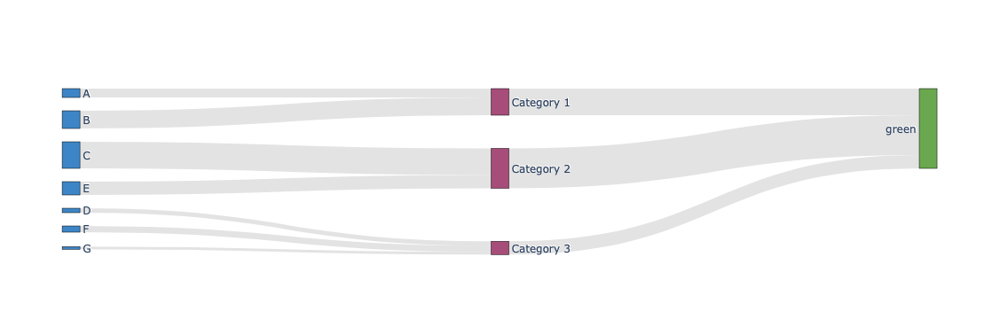

In [86]:
fig = go.Figure(data=[go.Sankey(
    node=dict(
        pad=15,
        thickness=20,
        line=dict(color="black", width=0.5),
        label = ap["label"],
        color= ap["cmap"],
        x = ap["x_position"],
        y = ap["y_position"]
    ),
    arrangement="snap",
    link=dict(
        source=ap["source"],
        target=ap["target"],
        value=ap["value"],
        color = "rgba(200,200,200,0.5)"
    ))])

fig.show()

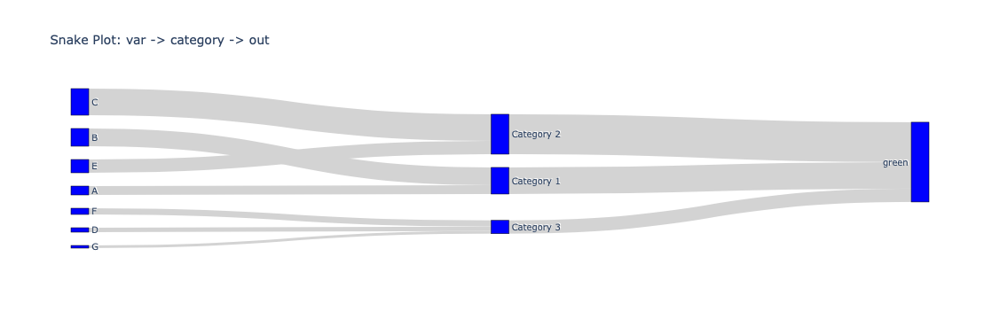

In [60]:
fig = go.Figure(go.Sankey(
    node=dict(
        pad=15,
        thickness=20,
        line=dict(color="black", width=0.5),
        label=all_labels,  # All unique labels (var, category, out)
        color="blue"  # Color for the nodes
    ),
    link=dict(
        source=ap["source"],  # Flows from var -> category and category -> out
        target=ap["target"],
        value=ap["value"],
        color="lightgrey"  # Color for the flow links
    )
))

# Set the layout title and display the plot
fig.update_layout(title_text="Snake Plot: var -> category -> out", font_size=10)
fig.show()

In [28]:
import pandas as pd
import numpy as np
from functools import reduce
from itertools import combinations
from matplotlib_venn import venn2 ,venn3, venn3_unweighted

In [81]:
def SankeyData_Plotly(df: pd.DataFrame, levels: list, value: str, omission: list = [], label_levels: list = [],cmap: dict = {}, sort: bool = True):
    
    """
    Prepare data for a Sankey diagram in Plotly from a DataFrame.

    Parameters:
    - df (pd.DataFrame): The input data.
    - levels (list): The columns in the DataFrame that define the levels of the Sankey diagram.
    - value (str): The column in the DataFrame that contains the values to be aggregated.
    - omission (list, optional): Values in the levels to be omitted. Defaults to an empty list.
    - label_levels (list, optional): Levels for which labels should be generated. Defaults to an empty list.
    - cmap (dict, optional): A dictionary mapping levels to colors. If empty, default colors will be used. Defaults to an empty dict.
    - sort (bool, optional): Whether to sort the DataFrame based on levels before processing. Defaults to True.

    Returns:
    dict: A dictionary containing the processed data for plotting a Sankey diagram and other lists needed in plotting.
    """
    
    ## Default colors for levels cmap is empty. 12 colors repeated.
    def_colors = ["#3d85c6", "#a64d79", "#6aa84f", "#cc0000", 
                  "#e69138", "#674ea7", "#16537e", "#c90076",
                  "#ffd966", "#bcbcbc", "#8fce00", "#000000"] * (len(levels) // 12 + 1)
    ## Color descriptions in matching order:
    # Steel Blue, Raspberry, Apple Green, Boston University Red,
    # Tiger Orange, Royal Purple, Lapis Blue, Magenta,
    # Banana Yellow, Silver Sand, Electric Lime, Black
    
    if sort:
        df.sort_values(levels, inplace = True)
        
    ## We want to omit based on the omission list
    # Use reduce to combine conditions for all specified columns
    # Condition is a list of bools
    condition = reduce(lambda x, y: x & y, [~df[col].isin(omission) for col in levels])
    
    ## Reshape df to only have unique values for each level
    ## Introduce index that matches the order of the level
    out = (pd.melt(df[condition],
                   value_vars = levels).
           drop_duplicates(['value']).
           reset_index(drop=True).
           reset_index().
           rename(columns = {"index":"source_idx",
                             "value":"source"})
          )

    ## Create value to index mapping
    index_dict = dict(zip(out["source"], out["source_idx"]))
    
    ## Get labels
    labels = out.apply(lambda row: row["source"] if row["variable"] in label_levels else "", axis = 1).to_list()
    
    ## Get x positions for plot
    x = np.linspace(0, 1, len(levels))
    # The starting and end point should not be exactly 0 or 1 but a value very close to it
    # Using boolean indexing instead of integer indexing helps avoid cases when we only have 1 element array
    x[x == 0] = 0.0001
    x[x == 1] = 0.999
    x_map = dict(zip(levels, x))
    x_positions = out["variable"].apply(lambda x: x_map[x]).to_list()
    
    ## Get y positions for plot
    # Function to apply linspace generation for each group
    def apply_linspace(group):
        count = len(group)
        y = np.linspace(0, 1, count)
        y[y == 0] = 0.0001
        y[y == 1] = 0.999
        group['y'] = y  # Direct assignment
        return group
    
    y_positions = out.groupby('variable', group_keys=False).apply(apply_linspace)["y"].to_list()
        
    ## Create color map from the larger color map supplied by user or using default colors
    if len(cmap) > 0:
        # Default to black if not found
        color_map = [cmap.get(i, def_colors[-1]) for i in index_dict.keys()]
    else:
        def_colors_map = dict(zip(levels, def_colors[:len(levels)]))
        color_map = out["variable"].apply(lambda x: def_colors_map[x]).to_list()

    ## Get starting dataframe which does not include the last level
    out = out[out["variable"] != levels[-1]].drop(columns = "variable")

    ## Create columns for target and values
    out["target"] = np.nan
    out["values"] = np.nan

    # For each successive pair in the levels list, we iterate over it and add information
    for source, target in zip(levels, levels[1:]):
        out = out.merge(df[[source, target, value]].groupby([source, target]).sum().reset_index().rename(columns = {source : "source"}),
                       how = "left",
                       on = "source")
        out["target"] = out["target"].combine_first(out[target])
        out["values"] = out["values"].combine_first(out[value])
        out.drop(columns=[target, value], inplace=True)
        
    # Add target idx
    out["target_idx"] = out["target"].apply(lambda x: index_dict.get(x, np.nan))
    
    # When omission list is populated, it means that we want to remove some values for different levels from being displayed
    # However we want their effect/value to be shown in source nodes
    # Other omissions whose effect does not wish to be shown in the plot should be omitted prior to inputting the df into the function
    out = out[(out["source_idx"].notna()) & (out["target_idx"].notna())]
    
    return {"dataframe" : out,
            "source" : out["source_idx"],
            "target" : out["target_idx"],
            "value" : out["values"],
            "label" : labels,
           "cmap" : color_map,
           "x_position" : x_positions,
           "y_position" : y_positions}

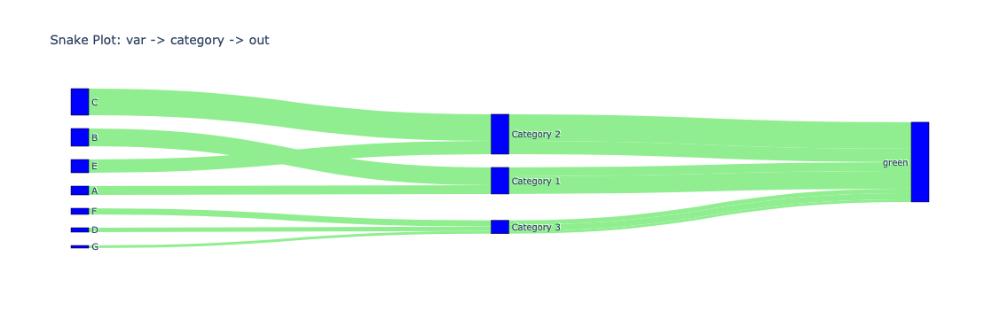

In [63]:
import pandas as pd
import plotly.graph_objects as go

# Sample categories for var
categories = {
    "A": "Category 1",
    "B": "Category 1",
    "C": "Category 2",
    "D": "Category 3",
    "E": "Category 2",
    "F": "Category 3",
    "G": "Category 3"
}

# Your data
rc = pd.DataFrame({
    "A_RC" : [0.1],
    "B_RC" : [0.2],
    "C_RC" : [0.3],
    "D_RC" : [0.05],
    "E_RC" : [0.15],
    "F_RC" : [0.07],
    "G_RC" : [0.03],
})

# Prepare the dataframe
rc = rc.transpose().rename(columns={0: "RC"})
rc["var"] = [i.replace("_RC", "") for i in rc.index.values]
rc["category"] = rc["var"].map(categories)
rc["out"] = "green"

# Define a custom order for all the labels (var, category, out)
# You can rearrange this order to control the order of the nodes
all_labels = ['A', 'B', 'C', 'D', 'E', 'F', 'G'] + ['Category 1', 'Category 2', 'Category 3'] + ['green']

# Define the Sankey diagram flow from var -> category -> out
sources = list(rc["var"].apply(lambda x: all_labels.index(x)))  # Indices of var
targets = list(rc["category"].apply(lambda x: all_labels.index(x)))  # Indices of category
out_targets = [all_labels.index("green")] * len(rc["category"])  # 'green' as the final node

# Combine the flows: var -> category and category -> out
sources += targets
targets += out_targets

# The values represent the RC values for the flows
values = list(rc["RC"]) + list(rc["RC"])

# Create the Sankey plot
fig = go.Figure(go.Sankey(
    node=dict(
        pad=15,
        thickness=20,
        line=dict(color="black", width=0.5),
        label=all_labels,  # All unique labels (var, category, out)
        color="blue"  # Color for the nodes
    ),
    link=dict(
        source=sources,  # Flows from var -> category and category -> out
        target=targets,
        value=values,
        color="lightgreen"  # Color for the flow links
    )
))

# Set the layout title and display the plot
fig.update_layout(title_text="Snake Plot: var -> category -> out", font_size=10)
fig.show()


In [89]:
import itertools
percentiles_sales = pd.DataFrame(
    {"perc": range(0, 101),
     "A": list(itertools.chain(range(20,0,-1) ,range(81))),
     "B": range(0, 101),
     "C": list(itertools.chain(range(20,50), range(50, 30, -1), range(30, 81))),
     "D": list(itertools.chain(range(50), range(50, 30, -1), range(30, 61))),
     "E": list(itertools.chain(range(40,20,-1), range(20, 51), range(50, 0, -1))),
     "F": list(itertools.chain(range(81,20,-1), range(20, 60))),
     "G": list(itertools.chain(range(70), range(70, 39, -1)))})

In [110]:
rel_con2

,A_Sales_RC,B_Sales_RC,C_Sales_RC,D_Sales_RC,E_Sales_RC,F_Sales_RC,G_Sales_RC
0,0.050638,0.317572,0.055618,0.315728,0.110267,0.020836,0.129340
1,0.150883,0.123152,0.058766,0.196388,0.065609,0.185726,0.219477
2,0.309015,0.027422,0.050372,0.215994,0.243890,0.085317,0.067990
3,0.199460,0.088976,0.154540,0.113477,0.095129,0.094839,0.253578
4,0.209779,0.050543,0.144674,0.154582,0.055943,0.222415,0.162064
...,...,...,...,...,...,...,...
95,0.147940,0.092534,0.236919,0.226005,0.030931,0.143436,0.122234
96,0.175664,0.052385,0.021731,0.252593,0.211367,0.260360,0.025901
97,0.192510,0.185602,0.077100,0.204896,0.066492,0.239951,0.033449
98,0.261402,0.016192,0.123035,0.026870,0.326082,0.089143,0.157275


In [101]:
np.mean(rel_con2.sum(axis=1) == 1)

0.64

In [102]:
cp =rel_con2.sum(axis=1)

In [105]:
cp[cp != 1]

0     1.0
5     1.0
8     1.0
9     1.0
11    1.0
13    1.0
19    1.0
21    1.0
23    1.0
24    1.0
28    1.0
32    1.0
38    1.0
44    1.0
45    1.0
46    1.0
58    1.0
59    1.0
61    1.0
62    1.0
67    1.0
68    1.0
71    1.0
77    1.0
78    1.0
80    1.0
81    1.0
82    1.0
84    1.0
87    1.0
88    1.0
89    1.0
90    1.0
91    1.0
97    1.0
98    1.0
dtype: float64

In [106]:
cp.loc[98]

1.0000000000000002

Orange
{'F': 0, 'G': 1, 'C': 2, 'D': 3, 'E': 4, 'A': 5, 'B': 6, 'Grow': 7, 'Leverage': 8, 'Liquidity': 9, 'Profitability': 10, 'Medium<br>Low': 11}


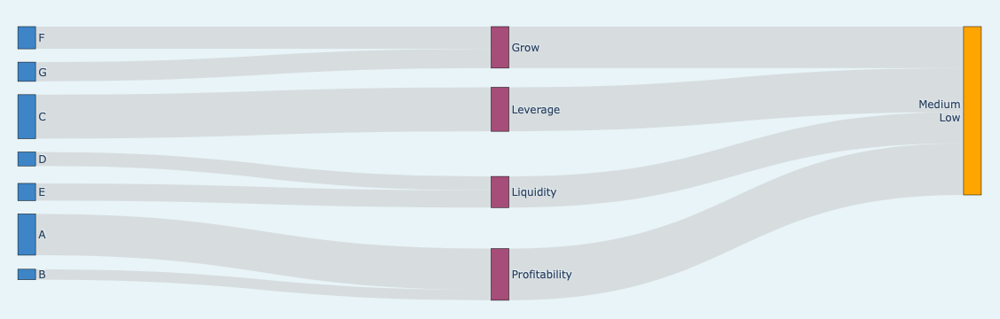

In [1]:
import numpy as np
import pandas as pd
import Setup
import Sankey_Plots as SKPlots

m = Setup.model_type_list[0]
df = Setup.df

sub = df.iloc[0]

value = sub[m + "P"]
# Determine the color and the corresponding text category based on the value
if value >= 75:
    color = "Green"
    category_text = "High"
elif value >= 50:
    color = "Yellow"
    category_text = "Medium<br>High"
elif value >= 25:
    color = "Orange"
    category_text = "Medium<br>Low"
else:
    color = "Red"
    category_text = "Low"
print(color)

rc = sub[sub.index.str.contains('_' + m + "_RC")].to_frame().rename(columns = {0 : "RC"}).assign(out = category_text)
rc = rc.assign(var = rc.index.str.replace("_" + m +"_RC", ""))
rc = rc.assign(category = rc["var"].map(Setup.ratio_categories)).sort_values("category")

from functools import reduce

cmap = reduce(lambda x, y: {**x, **y}, 
              [dict(zip(rc[i], [j] * len(rc))) 
               for i,j in dict(zip(["var","category","out"], ["#3d85c6", "#a64d79", color])).items()]
             )

out_sk = SKPlots.SankeyData_Plotly(rc, levels = ["var","category","out"], 
                                   value = "RC", label_levels = ["var","category","out"],
                                   sort = False,
                                   cmap = cmap)

fig1 = SKPlots.Sankey_plots(out_sk, Setup.BACKGROUND_COLOR)
fig1

In [3]:
fig1.layout

Layout({
    'autosize': True, 'paper_bgcolor': '#e8f4f8', 'plot_bgcolor': '#e8f4f8', 'template': '...'
})

In [4]:
fig1.frames

()

In [5]:
fig1.data

(Sankey({
     'arrangement': 'snap',
     'link': {'color': 'rgba(200,200,200,0.5)',
              'source': array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10]),
              'target': array([ 7,  7,  8,  9,  9, 10, 10, 11, 11, 11, 11]),
              'value': array([0.13208365, 0.1145019 , 0.26133691, 0.0827386 , 0.10225823, 0.24516791,
                              0.06191279, 0.24658556, 0.26133691, 0.18499683, 0.3070807 ])},
     'node': {'color': [#3d85c6, #3d85c6, #3d85c6, #3d85c6, #3d85c6, #3d85c6,
                        #3d85c6, #a64d79, #a64d79, #a64d79, #a64d79, Orange],
              'label': [F, G, C, D, E, A, B, Grow, Leverage, Liquidity,
                        Profitability, Medium<br>Low],
              'line': {'color': 'black', 'width': 0.5},
              'pad': 15,
              'thickness': 20,
              'x': [0.0001, 0.0001, 0.0001, 0.0001, 0.0001, 0.0001, 0.0001, 0.5,
                    0.5, 0.5, 0.5, 0.999],
              'y': [0.0001, 0.1666666666666666

In [7]:
import itertools

## Create risk segment metadata
colors_ews = ["Green", "Yellow", "Orange", "Red"]
naming = ["Ultra-Resilient", "Very Resileint", "Resilient", "Sensitive", "Elevated Risk", "Resurgent", "Distressed",
         "Emerging Risk", "Critical Risk", "Vulnerable", "Fragile", "Exposed"] * 2

# Get all possible combinations of 4 from the list
combinations = list(itertools.permutations(colors_ews, 4))
combos_final = {";".join(i) :naming[n]  for n,i in enumerate(combinations)}

combos_final

{'Green;Yellow;Orange;Red': 'Ultra-Resilient',
 'Green;Yellow;Red;Orange': 'Very Resileint',
 'Green;Orange;Yellow;Red': 'Resilient',
 'Green;Orange;Red;Yellow': 'Sensitive',
 'Green;Red;Yellow;Orange': 'Elevated Risk',
 'Green;Red;Orange;Yellow': 'Resurgent',
 'Yellow;Green;Orange;Red': 'Distressed',
 'Yellow;Green;Red;Orange': 'Emerging Risk',
 'Yellow;Orange;Green;Red': 'Critical Risk',
 'Yellow;Orange;Red;Green': 'Vulnerable',
 'Yellow;Red;Green;Orange': 'Fragile',
 'Yellow;Red;Orange;Green': 'Exposed',
 'Orange;Green;Yellow;Red': 'Ultra-Resilient',
 'Orange;Green;Red;Yellow': 'Very Resileint',
 'Orange;Yellow;Green;Red': 'Resilient',
 'Orange;Yellow;Red;Green': 'Sensitive',
 'Orange;Red;Green;Yellow': 'Elevated Risk',
 'Orange;Red;Yellow;Green': 'Resurgent',
 'Red;Green;Yellow;Orange': 'Distressed',
 'Red;Green;Orange;Yellow': 'Emerging Risk',
 'Red;Yellow;Green;Orange': 'Critical Risk',
 'Red;Yellow;Orange;Green': 'Vulnerable',
 'Red;Orange;Green;Yellow': 'Fragile',
 'Red;Orange;

In [43]:
import pandas as pd

color_mapping = {'Red': '#FF4136', 'Orange': '#FF851B', 'Yellow': '#FFDC00', 'Green': '#2ECC40'}
position_mapping = {'Red': 0.25, 'Orange': 0.5, 'Yellow': 0.75, 'Green': 1.0}
scenario_order_risk = ["", "s0", "bl", "s1"]
scenario_label_risk = ["Current", "Upside", "Baseline", "Downside"]

df_full = pd.DataFrame({
    "ews" : ["Green"],
    "ews_s0" : ["Yellow"],
    "ews_bl" : ["Orange"],
    "ews_s1" : ["Red"]
})
series = df_full.iloc[0]
series

ews        Green
ews_s0    Yellow
ews_bl    Orange
ews_s1       Red
Name: 0, dtype: object

In [44]:
def classification_grid_prep(series, color_mapping, position_mapping, order_scenario, label_scenario):

    # Convert to dataframe form
    df = series.rename("Classification").to_frame().reset_index(names = "Scenario")

    # Order based on scenario
    df['Scenario'] = pd.Categorical(df['Scenario'],
                                    categories = ["ews" + (f"_{i}" if i else "") for i in order_scenario], 
                                    ordered=True)

    # Create segment position and color in graph
    df['Color'] = df['Classification'].map(color_mapping)
    df['Position'] = df['Classification'].map(position_mapping)

    # Scenario labels. They follow order of order_scenario
    df["Label"] = label_scenario

    return df

In [45]:
df = classification_grid_prep(series, color_mapping, position_mapping, scenario_order_risk, scenario_label_risk)
df

,Scenario,Classification,Color,Position,Label
0,ews,Green,#2ECC40,1.00,Current
1,ews_s0,Yellow,#FFDC00,0.75,Upside
2,ews_bl,Orange,#FF851B,0.50,Baseline
3,ews_s1,Red,#FF4136,0.25,Downside


In [57]:
";".join(df["Classification"].values)

'Green;Yellow;Orange;Red'

In [68]:
import plotly.graph_objects as go
import pandas as pd


def classification_grid_plot(df):
    fig = go.Figure()
    
    # Adjust X-values to bring them closer
    x_positions = [0.125, 0.25, 0.375, 0.5]
    
    # Add color bands for each scenario with slight overlap to remove white lines
    overlap = 0.00005
    bar_width = 0.125
    for i, scenario in enumerate(df['Scenario']):
        for color, y in color_mapping.items():
            fig.add_shape(type="rect",
                          x0=x_positions[i] - bar_width/2 - overlap, y0=position_mapping[color] - bar_width,
                          x1=x_positions[i] + bar_width/2 + overlap, y1=position_mapping[color] + bar_width,
                          fillcolor=color_mapping[color],
                          opacity=0.5,
                          layer="below",
                          line_width=0)
    
    # Add a trace for the company's classification
    fig.add_trace(go.Scatter(
        x=x_positions,
        y=df['Position'],
        mode='lines+markers',
        line=dict(color='black', width=2),
        marker=dict(size=14, color=df['Color'], symbol='circle'),
        # text=df['Label'],
        hoverinfo='text'
    ))
    
    # Customize layout for aesthetics
    fig.update_layout(
        title="",
        xaxis_title="",
        yaxis_title="",
        yaxis=dict(tickvals=[0.25, 0.5, 0.75, 1.0],
                   ticktext=['', '', '', '']),
        plot_bgcolor='white',
        paper_bgcolor='white',
        font=dict(size=18),
        showlegend=False,
        xaxis=dict(
            tickmode='array',
            tickvals=x_positions,
            ticktext=df['Label']
        ),
        height=500,  # Adjust the height to make the plot square-shaped
        width=500,   # Set width to match height for square shape
        margin=dict(l=20, r=20, t=20, b=20)  # Adjust margins
    )

    return fig

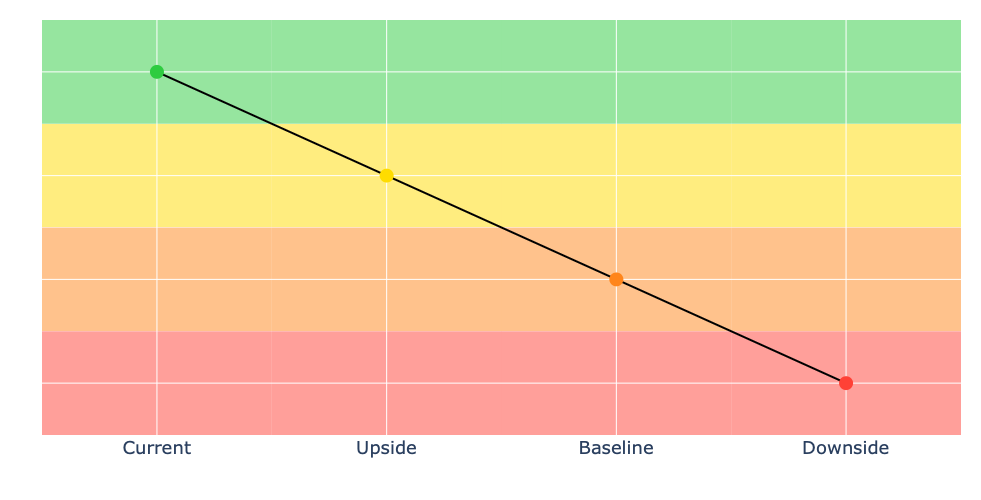

In [69]:
classification_grid_plot(df)

In [4]:
import dash
from dash import dcc, html
import plotly.express as px
import pandas as pd

# Sample data for the bar plot
df = pd.DataFrame({
    'Category': ['A', 'B', 'C', 'A', 'B', 'C'],
    'Value': [10, 20, 30, 40, 50, 60],
})

app = dash.Dash(__name__)

# Pre-determined label based on category combination (you can change the word here)
label = "Impact"

# Layout with bar plot and stylized label container side by side
app.layout = html.Div([
    # Flexbox container to hold the graph and label side by side
    html.Div(
        children=[
            # Bar plot
            dcc.Graph(id='bar-plot', figure=px.bar(df, x='Category', y='Value')),
            
            # Label container
            html.Div(
                children=label,
                style={
                    'fontSize': '60px',  # Large font size for emphasis
                    'color': '#FFFFFF',  # Text color (white)
                    'background': 'linear-gradient(135deg, #FF6347, #FF4500)',  # Gradient background
                    'padding': '30px 50px',  # Padding around the label
                    'borderRadius': '50px 15px 50px 15px',  # Creative rounded corners for shape
                    'boxShadow': '0px 10px 25px rgba(0, 0, 0, 0.5)',  # Drop shadow for depth
                    'textAlign': 'center',  # Center-align the text
                    'width': '350px',  # Width of the container
                    'margin': '10px',  # Small margin around the container
                    'fontWeight': 'bold',  # Bold text for emphasis
                    'fontFamily': 'Verdana, sans-serif',  # Clean and modern font
                    'border': '5px solid #FFFFFF',  # White border for pop effect
                    'transform': 'rotate(2deg)',  # Slight rotation for dynamic feel
                }
            )
        ],
        style={
            'display': 'flex',  # Use flexbox to arrange items side by side
            'justifyContent': 'space-around',  # Space them evenly
            'alignItems': 'center',  # Align items vertically in the center
            'flexWrap': 'wrap',  # Allow wrapping to next line on small screens
            'marginTop': '20px'  # Add space at the top
        }
    )
])

if __name__ == '__main__':
    app.run_server(debug=True)


In [1]:
import Setup

In [2]:
dp = Setup.df

In [5]:
import random

# Your list of 4 values
values = [1, 2, 3, 4]

# Sample n values from the list
n = 50  # Change this to the desired number of values to sample
random.choices(values, k = n)

[4,
 2,
 3,
 1,
 3,
 1,
 2,
 2,
 2,
 4,
 1,
 4,
 4,
 3,
 3,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 3,
 3,
 4,
 1,
 2,
 4,
 1,
 1,
 4,
 3,
 3,
 2,
 3,
 2,
 1,
 4,
 2,
 4,
 3,
 4,
 1,
 4,
 1,
 3,
 4,
 3,
 3,
 3]

In [24]:
import itertools
category_risk = ["Green", "Yellow", "Orange", "Red"]
naming = ["Ultra-Resilient", "Very Resileint", "Resilient", "Sensitive", "Elevated Risk", "Resurgent", "Distressed",
         "Emerging Risk", "Critical Risk", "Vulnerable", "Fragile", "Exposed"] * 22

# Get all possible combinations of 4 from the list
combinations = list(itertools.product(category_risk, repeat = 4))
segment_names = {";".join(i) :naming[n]  for n,i in enumerate(combinations)}

In [25]:
segment_names["Yellow;Yellow;Green;Yellow"]

'Vulnerable'

In [18]:
combinations = list(itertools.product(category_risk, repeat = 4))
len(combinations)

256

In [14]:
len(list(itertools.product(category_risk, repeat=4)))

256

In [20]:
len(naming)

252

In [21]:
len(["Ultra-Resilient", "Very Resileint", "Resilient", "Sensitive", "Elevated Risk", "Resurgent", "Distressed",
         "Emerging Risk", "Critical Risk", "Vulnerable", "Fragile", "Exposed"])

12

In [23]:
import numpy a256/13

19.692307692307693

In [35]:
import numpy as np
import pandas as pd
from matplotlib_venn import venn2 ,venn3, venn3_unweighted
from itertools import combinations
from functools import reduce
import matplotlib.pyplot as plt

def VennData(df: pd.DataFrame, segments: dict[str, str]) -> dict:
    """
    Get the count belonging to different segments of the Venn diagram.

    Parameters:
    - df (DataFrame): Get the counts after performing the filters
    - segments (dict): Dictionary where key-value pairs represent column names and their respective values of interest.
    
    Returns:
    dict with tuples of column names as keys and counts of matching rows as values.
    """
    
    # segments is a dict where the key is the column name and the value is the value of the column we are interested in
    
    out = {
    tuple(sub_tuple[0] for sub_tuple in comb) : # Extract the column names only
    np.sum(reduce(
        lambda x, y: x & y, 
        [df[col].isin([val] if not isinstance(val, (list, set, tuple)) else val) for col, val in comb] + # Inclusion principle
        [~df[col].isin([val] if not isinstance(val, (list, set, tuple)) else val) for col, val in segments.items() if col not in dict(comb).keys()] #Exclusion principle
    )) # Filter to get count for segments
    for size in range(1, len(segments) + 1) # Different combination sizes
    for comb in combinations(segments.items(), size) # Get the combination of size l
    }
    
    return out

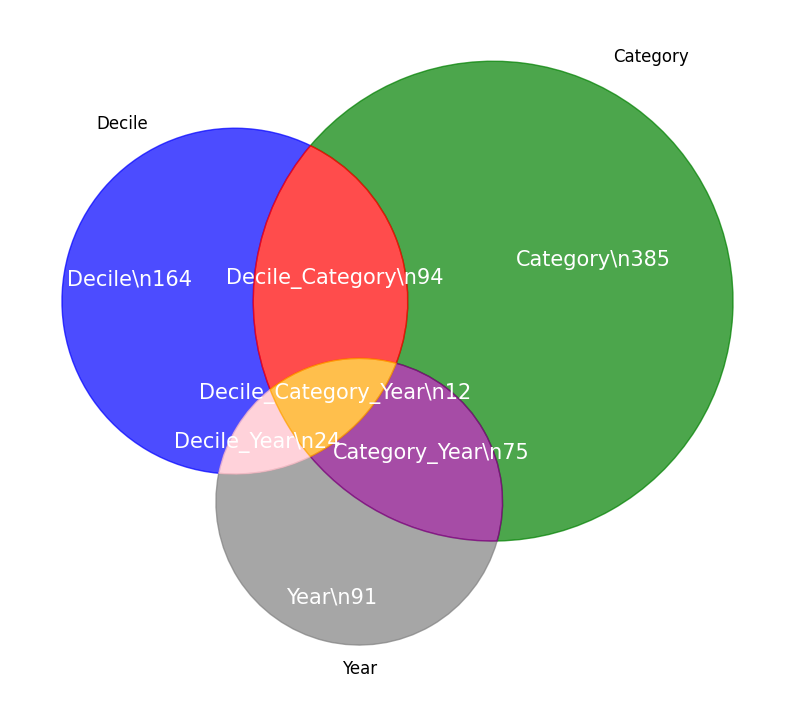

In [48]:
sectors = ['Technology', 'Healthcare', 'Finance', 'Consumer Goods', 'Energy']
years = np.arange(2000, 2024)  # From year 2000 to 2023
num_rows = np.random.randint(100, 2000)  # Random number of rows

# Generate random data
deciles = np.random.randint(1, 11, size=num_rows)  # Random deciles from 1 to 10
categories = np.random.choice(sectors, size=num_rows)  # Random sector for each row
random_years = np.random.choice(years, size=num_rows)  # Random year for each row

# Create the DataFrame
df = pd.DataFrame({
    'Decile': deciles,
    'Category': categories,
    'Year': random_years
})

## Get the values
segments = {"Decile":[9,10], "Category":["Energy","Technology"], "Year":[2012,2013,2020]}
out = VennData(df, segments)
A, B, C, AB, AC, BC, ABC = [*out.values()]
A_l, B_l, C_l, AB_l, AC_l, BC_l, ABC_l = [*out.keys()]

## Venn diagram input order: A,B,AB,C,AC,BC,ABC
plt.figure(figsize = (10,10))

venn = venn3(subsets = [A,B,AB,C,AC,BC,ABC],
            set_labels = (*segments.keys(),), # Labels for the circles
            alpha = 0.7)

## Set colors of segments
venn.get_patch_by_id("100").set_color("blue") #A
venn.get_patch_by_id("010").set_color("green") #B
venn.get_patch_by_id("110").set_color("red") #AB
venn.get_patch_by_id("001").set_color("gray") #C
venn.get_patch_by_id("101").set_color("pink") #AC
venn.get_patch_by_id("011").set_color("purple") #BC
venn.get_patch_by_id("111").set_color("orange") #ABC

# Label Text inside the segments
venn.get_label_by_id("100").set_text("_".join(A_l)+ "\\n" +str(A))
venn.get_label_by_id("010").set_text("_".join(B_l)+ "\\n" +str(B))
venn.get_label_by_id("110").set_text("_".join(AB_l)+ "\\n" +str(AB))
venn.get_label_by_id("001").set_text("_".join(C_l)+ "\\n" +str(C))
venn.get_label_by_id("101").set_text("_".join(AC_l)+ "\\n" +str(AC))
venn.get_label_by_id("011").set_text("_".join(BC_l)+ "\\n" +str(BC))
venn.get_label_by_id("111").set_text("_".join(ABC_l)+ "\\n" +str(ABC))

for text in venn.subset_labels:
    text.set_fontsize(15)
    text.set_color("white")

plt.show()

In [11]:
import matplotlib.pyplot as plt
from matplotlib_venn import venn3


def venn3_plot(labels, colors):
    
    # Define subset sizes
    subset_sizes = [1, 1, 0.3, 1, 0.3, 0.3, 0.15]  # Specify the subset sizes

    # Create the Venn diagram
    venn = venn3(subsets=subset_sizes, set_labels = labels,alpha = 1)

    # Hide all the labels (numbers inside the Venn diagram)
    for label in venn.set_labels:  # Set labels for the sets (A, B, C)
        label.set_fontsize(16)  # Adjust font size if desired

    for label in venn.subset_labels:  # Hide the subset values
        if label:  # Make sure the label exists
            label.set_text('')  # Remove the text by setting it to an empty string

    # Extract the middle patch (where A, B, and C overlap)
    middle_patch = venn.get_patch_by_id('111')

    # Get the face color of the middle patch
    middle_color = middle_patch.get_facecolor()

    return venn, middle_color

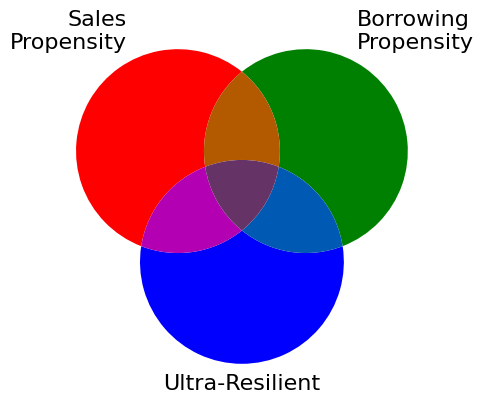

In [12]:
v,m = venn3_plot(["Sales\nPropensity", "Borrowing\nPropensity", "Ultra-Resilient"], ["Green", "Red", "#4682B4"])

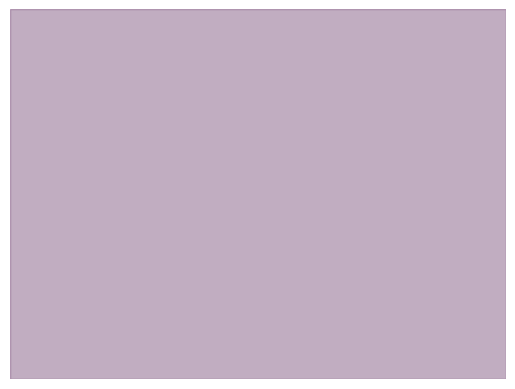

In [56]:
# Create a new figure to plot the color
fig, ax = plt.subplots()

# Plot a square filled with the extracted color
ax.add_patch(plt.Rectangle((0, 0), 1, 1, color=middle_color))

# Set limits and hide axes to make the square more visible
ax.set_xlim(0, 1)
ax.set_ylim(0, 1)
ax.axis('off')  # Turn off the axes for a cleaner look

# Display the plot with the extracted color
plt.show()

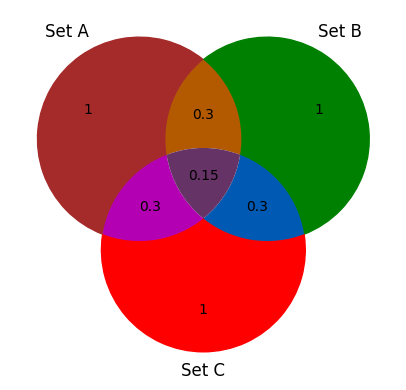

In [60]:
import matplotlib.pyplot as plt
from matplotlib_venn import venn3

# Define subset sizes
subset_sizes = [1, 1, 0.3, 1, 0.3, 0.3, 0.15]  # Subset sizes for the Venn diagram

# Create the Venn diagram
venn = venn3(subsets=subset_sizes, set_labels=('Set A', 'Set B', 'Set C'))

# Set custom colors for each circle
venn.get_patch_by_id('100').set_color('Brown')  # Set color for Set A (left circle)
venn.get_patch_by_id('010').set_color('Green')  # Set color for Set B (right circle)
venn.get_patch_by_id('001').set_color('Red')  # Set color for Set C (top circle)

# Adjust transparency (optional)
for region in ['100', '010', '001', '110', '101', '011', '111']:
    if venn.get_patch_by_id(region):
        venn.get_patch_by_id(region).set_alpha(1)  # Adjust transparency for all regions

# Display the plot with custom colors
plt.show()

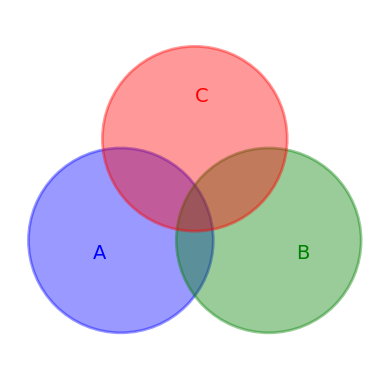

In [45]:
import matplotlib.pyplot as plt
from matplotlib.patches import Circle

# Create a new figure
fig, ax = plt.subplots()

# Define circle properties (positions, radius, colors, and fill)
# Adjust the circle positions to allow overlap while increasing separation
circle_A = Circle((-0.8, 0), 1, edgecolor='blue', facecolor='blue', alpha=0.4, linewidth=2, fill=True)
circle_B = Circle((0.8, 0), 1, edgecolor='green', facecolor='green', alpha=0.4, linewidth=2, fill=True)
circle_C = Circle((0, 1.1), 1, edgecolor='red', facecolor='red', alpha=0.4, linewidth=2, fill=True)

# Add circles to the plot
ax.add_patch(circle_A)
ax.add_patch(circle_B)
ax.add_patch(circle_C)

# Set equal aspect ratio so circles are not distorted
ax.set_aspect('equal')

# Set limits to ensure all circles are in view
ax.set_xlim(-2, 2)
ax.set_ylim(-1.5, 2.5)

# Remove axes for a clean look
ax.axis('off')

# Optionally add text for each section of the Venn diagram
ax.text(-1.1, -0.2, 'A', fontsize=14, color='blue')
ax.text(1.1, -0.2, 'B', fontsize=14, color='green')
ax.text(0, 1.5, 'C', fontsize=14, color='red')

# Display the plot
plt.show()


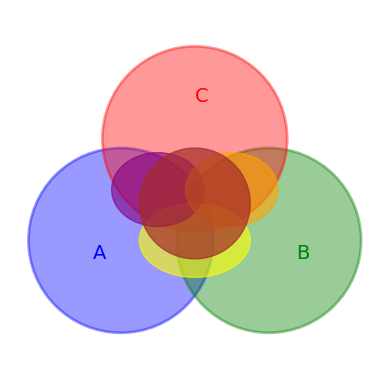

In [46]:
import matplotlib.pyplot as plt
from matplotlib.patches import Circle
from matplotlib import patches

# Create a new figure
fig, ax = plt.subplots()

# Define the circles (position, radius, color, and transparency)
circle_A = Circle((-0.8, 0), 1, edgecolor='blue', facecolor='blue', alpha=0.4, linewidth=2)
circle_B = Circle((0.8, 0), 1, edgecolor='green', facecolor='green', alpha=0.4, linewidth=2)
circle_C = Circle((0, 1.1), 1, edgecolor='red', facecolor='red', alpha=0.4, linewidth=2)

# Add the circles to the plot
ax.add_patch(circle_A)
ax.add_patch(circle_B)
ax.add_patch(circle_C)

# Manually color the overlap regions
# A & B overlap
overlap_AB = patches.Ellipse((0, 0), 1.2, 0.8, color='yellow', alpha=0.6)
ax.add_patch(overlap_AB)

# A & C overlap
overlap_AC = patches.Ellipse((-0.4, 0.55), 1, 0.8, color='purple', alpha=0.6)
ax.add_patch(overlap_AC)

# B & C overlap
overlap_BC = patches.Ellipse((0.4, 0.55), 1, 0.8, color='orange', alpha=0.6)
ax.add_patch(overlap_BC)

# ABC overlap
overlap_ABC = patches.Circle((0, 0.4), 0.6, color='brown', alpha=0.7)
ax.add_patch(overlap_ABC)

# Set equal aspect ratio so circles are not distorted
ax.set_aspect('equal')

# Set limits to ensure all circles are in view
ax.set_xlim(-2, 2)
ax.set_ylim(-1.5, 2.5)

# Remove axes for a clean look
ax.axis('off')

# Optionally add text for each section of the Venn diagram
ax.text(-1.1, -0.2, 'A', fontsize=14, color='blue')
ax.text(1.1, -0.2, 'B', fontsize=14, color='green')
ax.text(0, 1.5, 'C', fontsize=14, color='red')

# Display the plot
plt.show()


In [73]:
import matplotlib.pyplot as plt
from matplotlib_venn import venn3
from io import BytesIO
import base64

def venn3_plot(labels, colors):
    # Define subset sizes
    subset_sizes = [1, 1, 0.3, 1, 0.3, 0.3, 0.15]  # Specify the subset sizes

    # Create the Venn diagram
    venn = venn3(subsets=subset_sizes, set_labels=labels, alpha=0.5)

    # Hide all the labels (numbers inside the Venn diagram)
    for label in venn.set_labels:
        label.set_fontsize(16)

    for label in venn.subset_labels:
        if label:
            label.set_text('')  # Remove the text by setting it to an empty string

    # Extract the middle patch (where A, B, and C overlap)
    middle_patch = venn.get_patch_by_id('111')

    # Get the face color of the middle patch (convert to 0-255 scale)
    middle_color_rgba = middle_patch.get_facecolor()
    middle_color = f"rgba({int(middle_color_rgba[0] * 255)}, {int(middle_color_rgba[1] * 255)}, {int(middle_color_rgba[2] * 255)}, {middle_color_rgba[3]})"

    # Create an in-memory buffer to hold the image
    img_buf = BytesIO()
    plt.savefig(img_buf, format="png", bbox_inches='tight')  # Save plot to the buffer
    plt.close()  # Close the plot to avoid display in notebooks

    # Move the cursor to the beginning of the buffer
    img_buf.seek(0)

    # Convert the image in the buffer to a base64 string
    encoded_image = base64.b64encode(img_buf.getvalue()).decode('utf-8')

    # Create a base64 data URL
    img_data = f"data:image/png;base64,{encoded_image}"

    return img_data, middle_color


In [75]:
import dash
from dash import html

# Create the app
app = dash.Dash(__name__)

# Set labels and colors for the Venn diagram
labels = ['Set A', 'Set B', 'Set C']
colors = ['blue', 'green', 'red']

# Generate the Venn diagram and the middle patch color
venn_image, middle_color = venn3_plot(labels, colors)

# The narrative string
narrative = "This is a short paragraph that provides context or explanation for the Venn diagram."

# Layout of the app
app.layout = html.Div([
    html.Div([
        # Venn diagram image
        html.Img(src=venn_image, style={'height': '400px', 'width': '400px', 'padding': '10px'}),

        # Narrative text encapsulated in a box with background color matching middle patch
        html.Div([
            html.P(narrative, style={'padding': '10px', 'fontSize': '16px', 'color': '#000'}),
        ], style={
            'backgroundColor': middle_color,  # Set the background color to match the middle patch
            'borderRadius': '8px',  # Rounded corners for the box
            'padding': '10px',  # Padding inside the box
            'width': '400px',  # Same width as the image for balance
            'boxShadow': '2px 2px 12px rgba(0, 0, 0, 0.2)',  # Optional shadow for better effect
        })
    ], style={
        'display': 'flex',  # Flexbox layout to display image and text side by side
        'alignItems': 'center',  # Vertically align them in the center
        'justifyContent': 'space-around',  # Space them evenly
        'padding': '20px'
    })
])

if __name__ == '__main__':
    app.run_server(debug=True)


In [1]:
import Setup

In [2]:
db = Setup.df.iloc[0]

In [4]:
";".join(db[["ews" + (f"_{i}" if i else "") for i in Setup.scenario_order_risk]].values)

'Red;Green;Green;Red'

In [82]:
db

Names                Name1
Sales          1007.942844
Asset          1819.256505
Sector          Technology
Country                USA
                  ...     
C_Shrink_RC        0.52975
D_Shrink_RC       0.053484
E_Shrink_RC       0.119176
F_Shrink_RC       0.128206
G_Shrink_RC       0.117899
Name: 0, Length: 142, dtype: object

In [7]:
db.index.values

array(['Names', 'Sales', 'Asset', 'Sector', 'Country', 'Size', 'SalesP',
       'AssetP', 'ShrinkP', 'BorrowP', 'Sales_1', 'Sales_2', 'Sales_3',
       'Sales_4', 'Sales_5', 'Asset_1', 'Asset_2', 'Asset_3', 'Asset_4',
       'Asset_5', 'A_Sales', 'B_Sales', 'C_Sales', 'D_Sales', 'E_Sales',
       'F_Sales', 'G_Sales', 'A_Asset', 'B_Asset', 'C_Asset', 'D_Asset',
       'E_Asset', 'F_Asset', 'G_Asset', 'A_Borrow', 'B_Borrow',
       'C_Borrow', 'D_Borrow', 'E_Borrow', 'F_Borrow', 'G_Borrow',
       'A_Shrink', 'B_Shrink', 'C_Shrink', 'D_Shrink', 'E_Shrink',
       'F_Shrink', 'G_Shrink', 'Sales_H_cntry_size',
       'Sales_MH_cntry_size', 'Sales_ML_cntry_size', 'Sales_L_cntry_size',
       'Asset_H_cntry_size', 'Asset_MH_cntry_size', 'Asset_ML_cntry_size',
       'Asset_L_cntry_size', 'Borrow_H_cntry_size',
       'Borrow_MH_cntry_size', 'Borrow_ML_cntry_size',
       'Borrow_L_cntry_size', 'Shrink_H_cntry_size',
       'Shrink_MH_cntry_size', 'Shrink_ML_cntry_size',
       'Shrink_L_cnt